# Exploring Neighborhoods in Paris

## Information sources : 

#### From https://parisdata.opendatasoft.com/

1. Real estate Rental data (2019) : https://opendata.paris.fr/explore/dataset/logement-encadrement-des-loyers/download/?format=csv&timezone=Europe/Berlin&lang=fr&use_labels_for_header=true&csv_separator=%3B
   GeoJson file : https://opendata.paris.fr/explore/dataset/logement-encadrement-des-loyers/download/?format=geojson&timezone=Europe/Berlin&lang=fr

2. Department data : https://parisdata.opendatasoft.com/explore/dataset/quartier_paris/download/?format=csv&timezone=Europe/Berlin&lang=fr&use_labels_for_header=true&csv_separator=%3B
    
#### From https://www.data.gouv.fr
3. GeoJson Paris Districts : https://www.data.gouv.fr/fr/datasets/arrondissements-1/

#### From https://cadastre.data.gouv.fr/
4. Real estate Sales data (2019) : https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/
    
#### From https://developer.foursquare.com/ : location data

#### From https://fr.vikidia.org/wiki/Arrondissements_de_Paris : population data

### Import Libraries

In [1]:
import numpy as np
import pandas as pd
import requests
import seaborn as sns
import matplotlib.pyplot as plt
import csv
import json
import folium
from folium import plugins
%matplotlib inline
import sklearn


# !conda install -c anaconda xlrd

print('Done')

Done


## Neighborhood Rental Data

In [2]:
rent_df = pd.read_csv('logement-encadrement-des-loyers.csv', sep=';')
rent_df

,Secteurs géographiques,Numéro du quartier,Nom du quartier,Nombre de pièces principales,Epoque de construction,Type de location,Loyers de référence,Loyers de référence majorés,Loyers de référence minorés,Année,Ville,Numéro INSEE du quartier,geo_shape,geo_point_2d
0,2,13,Saint-Merri,2,Apres 1990,meublé,29.9,35.9,20.9,2017,PARIS,7510413,"{""type"": ""Polygon"", ""coordinates"": [[[2.352623...","48.8585213723,2.35166696714"
1,2,22,Odeon,4,1946-1970,non meublé,22.3,26.8,15.6,2017,PARIS,7510622,"{""type"": ""Polygon"", ""coordinates"": [[[2.336988...","48.8478006293,2.33633882759"
2,2,22,Odeon,4,1971-1990,non meublé,22.0,26.4,15.4,2017,PARIS,7510622,"{""type"": ""Polygon"", ""coordinates"": [[[2.336988...","48.8478006293,2.33633882759"
3,2,24,Saint-Germain-des-Prés,1,1971-1990,non meublé,27.4,32.9,19.2,2017,PARIS,7510624,"{""type"": ""Polygon"", ""coordinates"": [[[2.336959...","48.85528872,2.33365686809"
4,2,24,Saint-Germain-des-Prés,4,1946-1970,non meublé,22.3,26.8,15.6,2017,PARIS,7510624,"{""type"": ""Polygon"", ""coordinates"": [[[2.336959...","48.85528872,2.33365686809"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2555,4,20,Sorbonne,3,1946-1970,meublé,24.2,29.0,16.9,2017,PARIS,7510520,"{""type"": ""Polygon"", ""coordinates"": [[[2.349244...","48.8490447659,2.34574660019"
2556,4,20,Sorbonne,3,1971-1990,meublé,25.8,31.0,18.1,2017,PARIS,7510520,"{""type"": ""Polygon"", ""coordinates"": [[[2.349244...","48.8490447659,2.34574660019"
2557,2,21,Monnaie,2,Apres 1990,meublé,29.9,35.9,20.9,2017,PARIS,7510621,"{""type"": ""Polygon"", ""coordinates"": [[[2.343168...","48.8543844036,2.34003537113"
2558,2,21,Monnaie,3,Avant 1946,non meublé,26.2,31.4,18.3,2017,PARIS,7510621,"{""type"": ""Polygon"", ""coordinates"": [[[2.343168...","48.8543844036,2.34003537113"


In [3]:
rent_df.dtypes

Secteurs géographiques            int64
Numéro du quartier                int64
Nom du quartier                  object
Nombre de pièces principales      int64
Epoque de construction           object
Type de location                 object
Loyers de référence             float64
Loyers de référence majorés     float64
Loyers de référence minorés     float64
Année                             int64
Ville                            object
Numéro INSEE du quartier          int64
geo_shape                        object
geo_point_2d                     object
dtype: object

In [4]:
range(len(list(rent_df['geo_point_2d'])))

range(0, 2560)

In [5]:
#parse latitude and longitude, 

lat=[]
lon=[]
for i in range(len(list(rent_df['geo_point_2d']))):
    lat.append(float(list(rent_df['geo_point_2d'])[i].split(',')[0]))
    lon.append(float(list(rent_df['geo_point_2d'])[i].split(',')[1]))

In [6]:
# add lat, lon columns to dataframe
rent_df['lat']=lat
rent_df['lon']=lon
rent_df.head()

,Secteurs géographiques,Numéro du quartier,Nom du quartier,Nombre de pièces principales,Epoque de construction,Type de location,Loyers de référence,Loyers de référence majorés,Loyers de référence minorés,Année,Ville,Numéro INSEE du quartier,geo_shape,geo_point_2d,lat,lon
0,2,13,Saint-Merri,2,Apres 1990,meublé,29.9,35.9,20.9,2017,PARIS,7510413,"{""type"": ""Polygon"", ""coordinates"": [[[2.352623...","48.8585213723,2.35166696714",48.858521,2.351667
1,2,22,Odeon,4,1946-1970,non meublé,22.3,26.8,15.6,2017,PARIS,7510622,"{""type"": ""Polygon"", ""coordinates"": [[[2.336988...","48.8478006293,2.33633882759",48.847801,2.336339
2,2,22,Odeon,4,1971-1990,non meublé,22.0,26.4,15.4,2017,PARIS,7510622,"{""type"": ""Polygon"", ""coordinates"": [[[2.336988...","48.8478006293,2.33633882759",48.847801,2.336339
3,2,24,Saint-Germain-des-Prés,1,1971-1990,non meublé,27.4,32.9,19.2,2017,PARIS,7510624,"{""type"": ""Polygon"", ""coordinates"": [[[2.336959...","48.85528872,2.33365686809",48.855289,2.333657
4,2,24,Saint-Germain-des-Prés,4,1946-1970,non meublé,22.3,26.8,15.6,2017,PARIS,7510624,"{""type"": ""Polygon"", ""coordinates"": [[[2.336959...","48.85528872,2.33365686809",48.855289,2.333657


In [7]:
#change names and keep relevant columns

rent_df.rename(columns={"Secteurs géographiques": "sector", "Numéro du quartier": "neighborhood_number", "Nom du quartier": "neighborhood", \
                        "Nombre de pièces principales": "number_of_rooms",\
                        "Loyers de référence majorés": "rent_per_sqm", "Année": "year", "Ville": "city", \
                        "Type de location": "furnished"}, inplace=True)
rent_df.drop(columns=['Epoque de construction', 'sector',\
                      'Loyers de référence', 'Loyers de référence minorés', "geo_shape", "geo_point_2d", "Numéro INSEE du quartier"], inplace=True)

rent_df.replace('meublé', 1, inplace=True)
rent_df.replace('non meublé', 0, inplace=True)

rent_df.head()



,neighborhood_number,neighborhood,number_of_rooms,furnished,rent_per_sqm,year,city,lat,lon
0,13,Saint-Merri,2,1,35.9,2017,PARIS,48.858521,2.351667
1,22,Odeon,4,0,26.8,2017,PARIS,48.847801,2.336339
2,22,Odeon,4,0,26.4,2017,PARIS,48.847801,2.336339
3,24,Saint-Germain-des-Prés,1,0,32.9,2017,PARIS,48.855289,2.333657
4,24,Saint-Germain-des-Prés,4,0,26.8,2017,PARIS,48.855289,2.333657


In [8]:
rent_df.describe()

,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
count,2560.000000,2560.000000,2560.000000,2560.000000,2560.0,2560.000000,2560.000000
mean,40.500000,2.500000,0.500000,30.467578,2017.0,48.860991,2.343915
std,23.096718,1.118252,0.500098,4.871058,0.0,0.018317,0.034949
min,1.000000,1.000000,0.000000,18.100000,2017.0,48.823128,2.252277
25%,20.750000,1.750000,0.000000,27.100000,2017.0,48.848734,2.324470
50%,40.500000,2.500000,0.500000,30.100000,2017.0,48.862451,2.344880
75%,60.250000,3.250000,1.000000,33.400000,2017.0,48.873565,2.363586
max,80.000000,4.000000,1.000000,47.200000,2017.0,48.895556,2.433178


In [421]:
# average rent per neighborhood dataframe
rent_df_neighborhoods = rent_df.groupby("neighborhood").mean().sort_values(by=['rent_per_sqm'], ascending=True)
rent_df_neighborhoods

,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
neighborhood,,,,,,,
Charonne,80.0,2.5,0.5,24.718750,2017.0,48.854760,2.407430
Pont-de-Flandre,74.0,2.5,0.5,24.718750,2017.0,48.895556,2.384777
Villette,73.0,2.5,0.5,24.718750,2017.0,48.887661,2.374468
Saint-Fargeau,78.0,2.5,0.5,24.718750,2017.0,48.871035,2.406172
Gare,50.0,2.5,0.5,24.718750,2017.0,48.827527,2.372398
La Chapelle,72.0,2.5,0.5,24.718750,2017.0,48.894012,2.364387
Amérique,75.0,2.5,0.5,24.718750,2017.0,48.881638,2.395440
Bel-Air,45.0,2.5,0.5,26.921875,2017.0,48.837996,2.433178
Combat,76.0,2.5,0.5,26.921875,2017.0,48.878639,2.380127


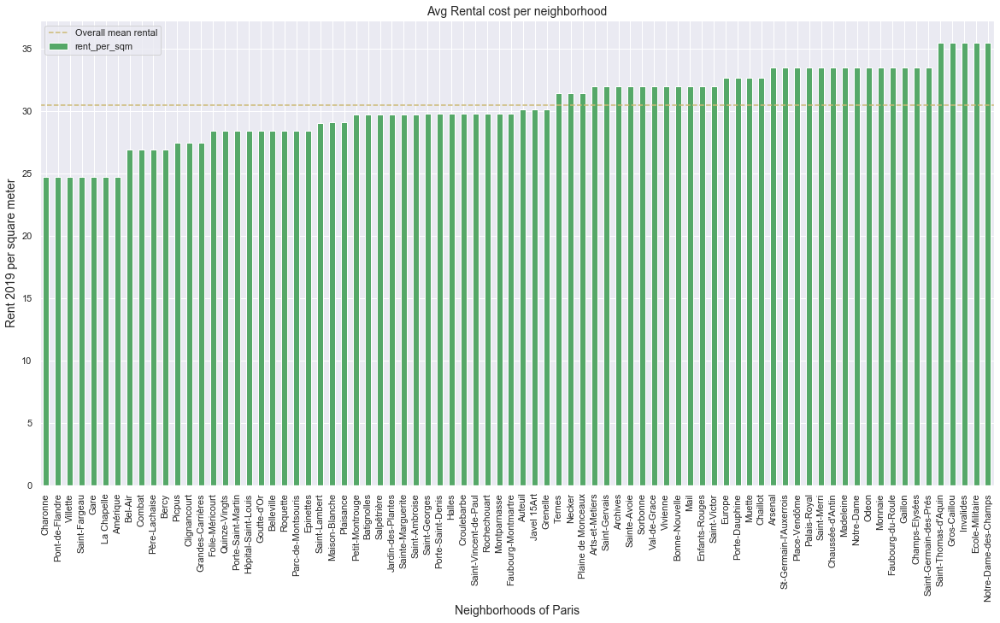

In [422]:
mean=rent_df_neighborhoods['rent_per_sqm'].mean()
mean

# Create bar chart on avg rent per neighborhood
rent_df_neighborhoods.plot(kind='bar', figsize=(20, 10), rot=90, y='rent_per_sqm', facecolor='g') # rotate the bars by 90 degrees

plt.axhline(mean, color='y', linestyle='--', label='Overall mean rental')

plt.xlabel('Neighborhoods of Paris', size=14)
plt.ylabel('Rent 2019 per square meter', size=14)
plt.title('Avg Rental cost per neighborhood', size=14)
plt.legend()


y=rent_df_neighborhoods['rent_per_sqm']

In [11]:
# reset index
rent_df_neighborhoods.reset_index(inplace=True)
rent_df_neighborhoods.head()

,neighborhood,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
0,Ecole-Militaire,27.0,2.5,0.5,35.5,2017.0,48.850359,2.311031
1,Notre-Dame-des-Champs,23.0,2.5,0.5,35.5,2017.0,48.846428,2.327357
2,Saint-Thomas-d'Aquin,25.0,2.5,0.5,35.5,2017.0,48.855263,2.325588
3,Invalides,26.0,2.5,0.5,35.5,2017.0,48.858515,2.316445
4,Gros-Caillou,28.0,2.5,0.5,35.5,2017.0,48.858300,2.301542


## District Sales data

In [12]:
#initialise dataframe
sales_df=pd.DataFrame()

# data sources
n1='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75101.csv'
n2='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75102.csv'
n3='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75103.csv'
n4='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75104.csv'
n5='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75105.csv'
n6='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75106.csv'
n7='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75107.csv'
n8='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75108.csv'
n9='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75109.csv'
n10='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75110.csv'
n11='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75111.csv'
n12='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75112.csv'
n13='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75113.csv'
n14='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75114.csv'
n15='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75115.csv'
n16='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75116.csv'
n17='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75117.csv'
n18='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75118.csv'
n19='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75119.csv'
n20='https://cadastre.data.gouv.fr/data/etalab-dvf/latest/csv/2019/communes/75/75120.csv'
n_all=[n1,n2,n3,n4,n5,n6,n7,n8,n9,n10,n11,n12,n13,n14,n15,n16,n17,n18,n19,n20]

#loading and wrangling functions
def loadsaledata(file, df):
    buy_df = pd.read_csv(file)
    buy_df1= buy_df[['code_postal','valeur_fonciere','type_local','nature_culture',\
                     'nombre_pieces_principales', 'surface_reelle_bati', 'longitude', 'latitude']].copy()
    buy_df1.dropna(subset = ['code_postal','valeur_fonciere','type_local',\
                     'nombre_pieces_principales', 'surface_reelle_bati', 'longitude', 'latitude'],inplace=True)
    buy_df1=buy_df1[buy_df1["nature_culture"].isnull()].reset_index(drop=True)
    buy_df1.drop('nature_culture', axis=1, inplace=True)
    buy_df1[["nombre_pieces_principales"]]=buy_df1[["nombre_pieces_principales"]].astype(int)
    #buy_df1["type_local"]=buy_df1["type_local"].apply(lambda x: x.replace('','')).astype(str)
    buy_df1['type_local'] = buy_df1.type_local.str.replace('$', '').astype(str)
    buy_df1=buy_df1.loc[buy_df1['type_local'] == 'Appartement']
    buy_df1['sale_per_sqm']=buy_df1['valeur_fonciere']/buy_df1['surface_reelle_bati']
    buy_df1['code_postal']=buy_df1['code_postal']-75000
    b= pd.concat([df, buy_df1], sort=False).reset_index(drop=True)
    return b

In [13]:
# load all files and append to dataframe
for i in n_all:
    sales_df=loadsaledata(i,sales_df)

In [14]:
# remove abnormal transactions from df. Abnormal transaction above 40 0000 € and below 2000 € per square meter
sales_df=sales_df.loc[(sales_df['sale_per_sqm']<40000) & (sales_df['sale_per_sqm']>2000) ]

In [15]:
# check dataframe
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30805 entries, 0 to 32917
Data columns (total 8 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   code_postal                30805 non-null  float64
 1   valeur_fonciere            30805 non-null  float64
 2   type_local                 30805 non-null  object 
 3   nombre_pieces_principales  30805 non-null  int32  
 4   surface_reelle_bati        30805 non-null  float64
 5   longitude                  30805 non-null  float64
 6   latitude                   30805 non-null  float64
 7   sale_per_sqm               30805 non-null  float64
dtypes: float64(6), int32(1), object(1)
memory usage: 2.0+ MB


In [16]:
sales_df.head()

,code_postal,valeur_fonciere,type_local,nombre_pieces_principales,surface_reelle_bati,longitude,latitude,sale_per_sqm
0,1.0,1196000.0,Appartement,3,112.0,2.325288,48.868416,10678.571429
1,1.0,1935600.0,Appartement,2,66.0,2.337119,48.865114,29327.272727
2,1.0,209000.0,Appartement,1,19.0,2.337476,48.866524,11000.000000
3,1.0,752400.0,Appartement,3,75.0,2.345875,48.864218,10032.000000
4,1.0,530000.0,Appartement,2,46.0,2.343732,48.858427,11521.739130


In [17]:
sales_district_df=sales_df.groupby('code_postal').mean()['sale_per_sqm']

In [18]:
sales_district_sorted=sales_district_df.sort_values(axis=0, ascending=True, inplace=False)

In [19]:
sales_district_sorted

code_postal
19.0     8837.313002
20.0     9046.189635
13.0     9872.322437
12.0    10013.739743
18.0    10066.068677
11.0    10341.288879
15.0    10534.075051
10.0    10818.260408
17.0    11013.844987
14.0    11127.463471
2.0     11552.363970
16.0    11603.811020
9.0     11662.342213
3.0     12647.411686
8.0     12918.311243
5.0     13037.819409
1.0     13394.495015
4.0     13992.603528
7.0     15024.348240
6.0     15425.011630
Name: sale_per_sqm, dtype: float64

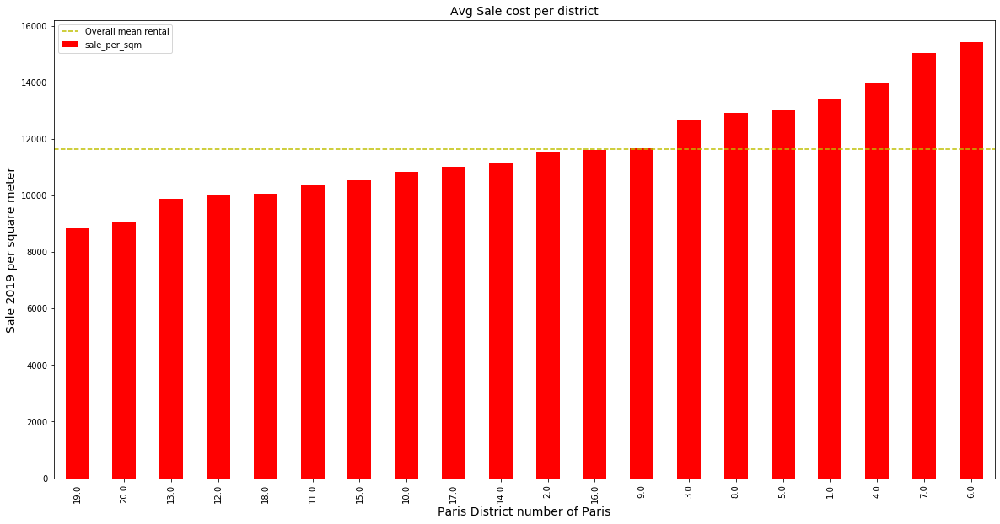

In [20]:
# Create bar chart on avg value per sqm per neighborhood
plt.figure()
sales_district_sorted.plot(kind='bar', figsize=(20, 10), rot=90, y='sale_per_sqm', facecolor='r') # rotate the bars by 90 degrees

plt.axhline(sales_district_sorted.mean(), color='y', linestyle='--', label='Overall mean rental')

plt.xlabel('Paris District number of Paris', size=14)
plt.ylabel('Sale 2019 per square meter', size=14)
plt.title('Avg Sale cost per district', size=14)
plt.legend()


In [21]:
sales_district_df

code_postal
1.0     13394.495015
2.0     11552.363970
3.0     12647.411686
4.0     13992.603528
5.0     13037.819409
6.0     15425.011630
7.0     15024.348240
8.0     12918.311243
9.0     11662.342213
10.0    10818.260408
11.0    10341.288879
12.0    10013.739743
13.0     9872.322437
14.0    11127.463471
15.0    10534.075051
16.0    11603.811020
17.0    11013.844987
18.0    10066.068677
19.0     8837.313002
20.0     9046.189635
Name: sale_per_sqm, dtype: float64

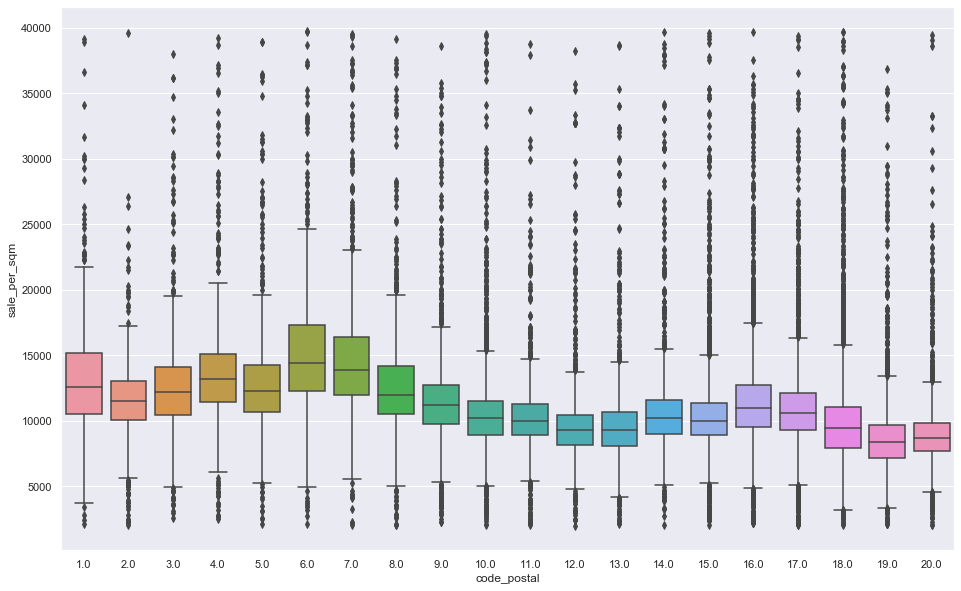

In [22]:
sns.set(rc={'figure.figsize':(16,10)})
ax = sns.boxplot(x="code_postal", y="sale_per_sqm",
                 data=sales_df)

### Modify dataframe to include a District column.

In [23]:
sales_district_df.index=sales_district_df.index.astype('int')

In [24]:
sales_district_df=sales_district_df.reset_index()

In [25]:
sales_district_df.rename(columns={'index': 'distr'}, inplace=True)

In [26]:
sales_district_df

,distr,sale_per_sqm
0,1,13394.495015
1,2,11552.363970
2,3,12647.411686
3,4,13992.603528
4,5,13037.819409
5,6,15425.011630
6,7,15024.348240
7,8,12918.311243
8,9,11662.342213
9,10,10818.260408


## Districts and relation with Neighborhoods

In [27]:
districts_df = pd.read_csv('quartier_paris.csv', sep=';')
districts_df.head()

,N_SQ_QU,C_QU,C_QUINSEE,L_QU,C_AR,N_SQ_AR,PERIMETRE,SURFACE,Geometry X Y,Geometry
0,750000013,13,7510401,Saint-Merri,4,750000004,2346.004687,3.130404e+05,"48.8585213723,2.35166696714","{""type"": ""Polygon"", ""coordinates"": [[[2.352623..."
1,750000016,16,7510404,Notre-Dame,4,750000004,3283.163371,3.782522e+05,"48.8528955862,2.35277501212","{""type"": ""Polygon"", ""coordinates"": [[[2.361313..."
2,750000028,28,7510704,Gros-Caillou,7,750000007,4720.994373,1.381893e+06,"48.8582999039,2.30154155569","{""type"": ""Polygon"", ""coordinates"": [[[2.309544..."
3,750000023,23,7510603,Notre-Dame-des-Champs,6,750000006,4559.989773,8.613070e+05,"48.846427594,2.32735687823","{""type"": ""Polygon"", ""coordinates"": [[[2.336756..."
4,750000055,55,7511403,Petit-Montrouge,14,750000014,5490.636672,1.345774e+06,"48.8266526255,2.32643699922","{""type"": ""Polygon"", ""coordinates"": [[[2.329136..."


In [28]:
# Map the lowering function to all column names
districts_df.columns = map(str.lower, districts_df.columns)
districts_df.head()

,n_sq_qu,c_qu,c_quinsee,l_qu,c_ar,n_sq_ar,perimetre,surface,geometry x y,geometry
0,750000013,13,7510401,Saint-Merri,4,750000004,2346.004687,3.130404e+05,"48.8585213723,2.35166696714","{""type"": ""Polygon"", ""coordinates"": [[[2.352623..."
1,750000016,16,7510404,Notre-Dame,4,750000004,3283.163371,3.782522e+05,"48.8528955862,2.35277501212","{""type"": ""Polygon"", ""coordinates"": [[[2.361313..."
2,750000028,28,7510704,Gros-Caillou,7,750000007,4720.994373,1.381893e+06,"48.8582999039,2.30154155569","{""type"": ""Polygon"", ""coordinates"": [[[2.309544..."
3,750000023,23,7510603,Notre-Dame-des-Champs,6,750000006,4559.989773,8.613070e+05,"48.846427594,2.32735687823","{""type"": ""Polygon"", ""coordinates"": [[[2.336756..."
4,750000055,55,7511403,Petit-Montrouge,14,750000014,5490.636672,1.345774e+06,"48.8266526255,2.32643699922","{""type"": ""Polygon"", ""coordinates"": [[[2.329136..."


In [29]:
#merge rent_df_neighborhoods to districts_df
newdis_df=districts_df.merge(rent_df_neighborhoods, left_on='c_qu', right_on='neighborhood_number')

In [30]:
#change names and keep relevant columns

newdis_df.rename(columns={"c_qu": "neighborhood_n", "l_qu": "neighborhood_name", "c_ar": "district"}, inplace=True)
newdis_df.drop(columns=['n_sq_qu', 'n_sq_ar', 'geometry x y'], inplace=True)
newdis_df


,neighborhood_n,c_quinsee,neighborhood_name,district,perimetre,surface,geometry,neighborhood,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
0,13,7510401,Saint-Merri,4,2346.004687,3.130404e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.352623...",Saint-Merri,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
1,16,7510404,Notre-Dame,4,3283.163371,3.782522e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.361313...",Notre-Dame,16.0,2.5,0.5,33.500000,2017.0,48.852896,2.352775
2,28,7510704,Gros-Caillou,7,4720.994373,1.381893e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.309544...",Gros-Caillou,28.0,2.5,0.5,35.500000,2017.0,48.858300,2.301542
3,23,7510603,Notre-Dame-des-Champs,6,4559.989773,8.613070e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.336756...",Notre-Dame-des-Champs,23.0,2.5,0.5,35.500000,2017.0,48.846428,2.327357
4,55,7511403,Petit-Montrouge,14,5490.636672,1.345774e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.329136...",Petit-Montrouge,55.0,2.5,0.5,29.740625,2017.0,48.826653,2.326437
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,37,7511001,Saint-Vincent-de-Paul,10,4072.789633,9.268652e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.360513...",Saint-Vincent-de-Paul,37.0,2.5,0.5,29.846875,2017.0,48.880735,2.357471
76,42,7511102,Saint-Ambroise,11,4052.567737,8.379929e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.370939...",Saint-Ambroise,42.0,2.5,0.5,29.740625,2017.0,48.862345,2.376118
77,45,7511201,Bel-Air,12,18427.822238,5.970921e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.413879...",Bel-Air,45.0,2.5,0.5,26.921875,2017.0,48.837996,2.433178
78,53,7511401,Montparnasse,14,4565.136189,1.126205e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.341585...",Montparnasse,53.0,2.5,0.5,29.846875,2017.0,48.837623,2.331784


In [31]:
len(newdis_df.district.unique())
# create color dictionary
bor=list(newdis_df['district'].unique())
col=['red', 'blue', 'green', 'purple', 'orange', 'darkred','lightred', 'beige', 'darkblue', 'darkgreen',  \
    'darkpurple', 'white', 'pink', 'cadetblue', 'lightgray','black', \
     'RGB(100,0,0)','RGB(0,100,0)','RGB(0,0,100)','RGB(200,0,0)','RGB(0,200,0)','RGB(0,0,200)']
dictionary = dict(zip(bor, col))

In [32]:
latitude=rent_df['lat'].values.mean() 
longitude=rent_df['lon'].values.mean() 
print('Average coordinates = ', latitude, longitude)

Average coordinates =  48.86099104104 2.343915487651625


In [33]:
# Create map

latitude=rent_df['lat'].values.mean()
longitude=rent_df['lon'].values.mean()
print('Average coordinates = ', latitude, longitude)


paris_map = folium.Map(location=[latitude, longitude], zoom_start=12,  tiles='Stamen Terrain') # generate map centred around latitude, Longitude

# create color dictionary
bor=list(newdis_df['district'].unique())
col=['red', 'blue', 'green', 'purple', 'orange', 'darkred','lightred', 'beige', 'darkblue', 'darkgreen',  \
    'darkpurple', 'white', 'pink', 'cadetblue', 'lightgray','black', \
     'RGB(100,0,0)','RGB(0,100,0)','RGB(0,0,100)','RGB(200,0,0)','RGB(0,200,0)','RGB(0,0,200)']
dictionary = dict(zip(bor, col))

# add district markers to map 
for lat, lng, district, neighborhood, rent in zip(newdis_df['lat'], newdis_df['lon'],\
                                                  newdis_df['district'], newdis_df['neighborhood'], newdis_df['rent_per_sqm']):
    label = '{}, {}'.format(district, neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=rent/4,
        popup=label,
        color=dictionary.get(district),
        fill=True,
        fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris_map)  
    
paris_map

Average coordinates =  48.86099104104 2.343915487651625


## Mapping rent per neighborhood

In [34]:
df1=newdis_df[['neighborhood_n', 'rent_per_sqm']]
df1

,neighborhood_n,rent_per_sqm
0,13,33.500000
1,16,33.500000
2,28,35.500000
3,23,35.500000
4,55,29.740625
...,...,...
75,37,29.846875
76,42,29.740625
77,45,26.921875
78,53,29.846875


In [35]:
df1[['neighborhood_n','rent_per_sqm']]

,neighborhood_n,rent_per_sqm
0,13,33.500000
1,16,33.500000
2,28,35.500000
3,23,35.500000
4,55,29.740625
...,...,...
75,37,29.846875
76,42,29.740625
77,45,26.921875
78,53,29.846875


In [36]:
geo = json.load(open("quartier_paris.geojson"))

In [37]:
df = pd.DataFrame({
    "district" : [dist["properties"]["c_qu"] for dist in geo["features"]]
})
df

,district
0,13
1,16
2,28
3,23
4,55
...,...
75,37
76,42
77,45
78,53


In [38]:
#merge rent_df_neighborhoods to districts_df
df=df.merge(df1, left_on='district', right_on='neighborhood_n')
df.drop(columns=['neighborhood_n'], inplace=True)
df

,district,rent_per_sqm
0,13,33.500000
1,16,33.500000
2,28,35.500000
3,23,35.500000
4,55,29.740625
...,...,...
75,37,29.846875
76,42,29.740625
77,45,26.921875
78,53,29.846875


In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 80 entries, 0 to 79
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   district      80 non-null     int64  
 1   rent_per_sqm  80 non-null     float64
dtypes: float64(1), int64(1)
memory usage: 1.9 KB


### Plot relation between Neighborhoods and Districts

In [40]:
geo = json.load(open("quartier_paris.geojson"))

paris = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo
).add_to(paris)



folium.LayerControl().add_to(paris)


# add district markers to map, colored by District and with surface proportional to rent 
for lat, lng, district, neighborhood, rent in zip(newdis_df['lat'], newdis_df['lon'],\
                                                  newdis_df['district'], newdis_df['neighborhood'], newdis_df['rent_per_sqm']):
    label = '{}, {}'.format(district, neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=rent/4,
        popup=label,
        color=dictionary.get(district),
        fill=True,
        fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris)  
    
paris


### Plot Chloropleth map of rent per neighborhood in relation with District

In [41]:
geo = json.load(open("quartier_paris.geojson"))

paris = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo, 
    data = df,
    columns = ['district', 'rent_per_sqm'],
    key_on = 'feature.properties.c_qu',
    #fill_color='YlGn',
    fill_color='PuOr',
    #fill_opacity=0.8,
    #line_opacity=0.2,
    legend_name='Monthly Rent in Euro per square meter',

).add_to(paris)



folium.LayerControl().add_to(paris)


# add district markers to map, colored by District and with surface proportional to rent 
for lat, lng, district, neighborhood, rent in zip(newdis_df['lat'], newdis_df['lon'],\
                                                  newdis_df['district'], newdis_df['neighborhood'], newdis_df['rent_per_sqm']):
    label = '{}, {}'.format(district, neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=rent/4,
        popup=label,
        color=dictionary.get(district),
        fill=True,
        fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris)  
    
paris


## Population density and relation with rent

In [42]:
url = 'https://fr.vikidia.org/wiki/Arrondissements_de_Paris'
html = requests.get(url).content
df_list = pd.read_html(html)
pop_df = df_list[0]
pop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       0 non-null      float64
 1   1       21 non-null     object 
 2   2       21 non-null     object 
 3   3       21 non-null     object 
 4   4       21 non-null     object 
dtypes: float64(1), object(4)
memory usage: 968.0+ bytes


In [43]:
# Replace header with first row
new_header = pop_df.iloc[0] #grab the first row for the header
pop_df = pop_df[1:] #take the data less the header row
pop_df.columns = new_header #set the header row as the df header

In [44]:
pop_df = pop_df.dropna(axis=1).reset_index()
pop_df

,index,Arrondissement de Paris,Superficie (hectares),Population (habitants),Densité (hab/ha)
0,1,Paris 1er arrondissement,183,17 100,93
1,2,Paris 2e arrondissement,99,22 390,227
2,3,Paris 3e arrondissement,117,35 991,307
3,4,Paris 4e arrondissement,160,27 769,173
4,5,Paris 5e arrondissement,254,60 179,236
5,6,Paris 6e arrondissement,215,43 224,201
6,7,Paris 7e arrondissement,409,57 092,139
7,8,Paris 8e arrondissement,388,38 749,99
8,9,Paris 9e arrondissement,218,59 474,272
9,10,Paris 10e arrondissement,289,94 474,326


In [45]:
pop_df.rename(columns={"index": "district_n", "Arrondissement de Paris": "district_name", "Superficie (hectares)": \
                       "Surface (hectars)","Densité (hab/ha)": "Density (hab/hectar)"}, inplace=True)

# replace density column with numerical values
density = pop_df['Density (hab/hectar)'].astype(str).astype(float) # convert object to float and get list
pop_df.drop(['Density (hab/hectar)'], axis = 1, inplace = True) #drop column
pop_df['Density (hab/hectar)']= density                                 #replace column with list



In [46]:
pop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 5 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   district_n              20 non-null     int64  
 1   district_name           20 non-null     object 
 2   Surface (hectars)       20 non-null     object 
 3   Population (habitants)  20 non-null     object 
 4   Density (hab/hectar)    20 non-null     float64
dtypes: float64(1), int64(1), object(3)
memory usage: 928.0+ bytes


In [47]:
pop_df

,district_n,district_name,Surface (hectars),Population (habitants),Density (hab/hectar)
0,1,Paris 1er arrondissement,183,17 100,93.0
1,2,Paris 2e arrondissement,99,22 390,227.0
2,3,Paris 3e arrondissement,117,35 991,307.0
3,4,Paris 4e arrondissement,160,27 769,173.0
4,5,Paris 5e arrondissement,254,60 179,236.0
5,6,Paris 6e arrondissement,215,43 224,201.0
6,7,Paris 7e arrondissement,409,57 092,139.0
7,8,Paris 8e arrondissement,388,38 749,99.0
8,9,Paris 9e arrondissement,218,59 474,272.0
9,10,Paris 10e arrondissement,289,94 474,326.0


In [48]:
district_rent_df=newdis_df[['district', 'rent_per_sqm', 'lat', 'lon']].groupby(['district']).mean().reset_index()
district_rent_df

,district,rent_per_sqm,lat,lon
0,1,32.586719,48.863654,2.336175
1,2,32.372656,48.868391,2.341918
2,3,31.996875,48.863027,2.359566
3,4,33.124219,48.854680,2.356843
4,5,31.432813,48.845083,2.350149
5,6,34.000000,48.850975,2.334347
6,7,35.500000,48.855609,2.313651
7,8,33.293750,48.872656,2.312500
8,9,30.760156,48.876807,2.338308
9,10,29.134375,48.875401,2.359845


In [49]:
dis_ren_pop_df=pd.DataFrame()
dis_ren_pop_df = pd.concat([district_rent_df, pop_df], axis=1, join='inner')
dis_ren_pop_df

,district,rent_per_sqm,lat,lon,district_n,district_name,Surface (hectars),Population (habitants),Density (hab/hectar)
0,1,32.586719,48.863654,2.336175,1,Paris 1er arrondissement,183,17 100,93.0
1,2,32.372656,48.868391,2.341918,2,Paris 2e arrondissement,99,22 390,227.0
2,3,31.996875,48.863027,2.359566,3,Paris 3e arrondissement,117,35 991,307.0
3,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0
4,5,31.432813,48.845083,2.350149,5,Paris 5e arrondissement,254,60 179,236.0
5,6,34.000000,48.850975,2.334347,6,Paris 6e arrondissement,215,43 224,201.0
6,7,35.500000,48.855609,2.313651,7,Paris 7e arrondissement,409,57 092,139.0
7,8,33.293750,48.872656,2.312500,8,Paris 8e arrondissement,388,38 749,99.0
8,9,30.760156,48.876807,2.338308,9,Paris 9e arrondissement,218,59 474,272.0
9,10,29.134375,48.875401,2.359845,10,Paris 10e arrondissement,289,94 474,326.0


In [50]:
sales_district_df

,distr,sale_per_sqm
0,1,13394.495015
1,2,11552.363970
2,3,12647.411686
3,4,13992.603528
4,5,13037.819409
5,6,15425.011630
6,7,15024.348240
7,8,12918.311243
8,9,11662.342213
9,10,10818.260408


In [51]:
dis_ren_pop_df = pd.merge(dis_ren_pop_df, sales_district_df, left_on='district', right_on='distr')
dis_ren_pop_df

,district,rent_per_sqm,lat,lon,district_n,district_name,Surface (hectars),Population (habitants),Density (hab/hectar),distr,sale_per_sqm
0,1,32.586719,48.863654,2.336175,1,Paris 1er arrondissement,183,17 100,93.0,1,13394.495015
1,2,32.372656,48.868391,2.341918,2,Paris 2e arrondissement,99,22 390,227.0,2,11552.363970
2,3,31.996875,48.863027,2.359566,3,Paris 3e arrondissement,117,35 991,307.0,3,12647.411686
3,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0,4,13992.603528
4,5,31.432813,48.845083,2.350149,5,Paris 5e arrondissement,254,60 179,236.0,5,13037.819409
5,6,34.000000,48.850975,2.334347,6,Paris 6e arrondissement,215,43 224,201.0,6,15425.011630
6,7,35.500000,48.855609,2.313651,7,Paris 7e arrondissement,409,57 092,139.0,7,15024.348240
7,8,33.293750,48.872656,2.312500,8,Paris 8e arrondissement,388,38 749,99.0,8,12918.311243
8,9,30.760156,48.876807,2.338308,9,Paris 9e arrondissement,218,59 474,272.0,9,11662.342213
9,10,29.134375,48.875401,2.359845,10,Paris 10e arrondissement,289,94 474,326.0,10,10818.260408


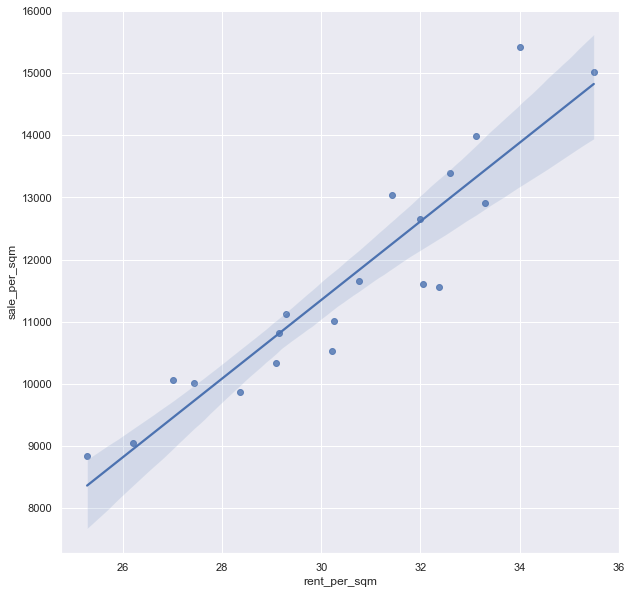

In [52]:
#"Sales vs. Rent analysis"
sns.set(rc={'figure.figsize':(10,10)})
g =sns.regplot(x="rent_per_sqm", y="sale_per_sqm", 
              data=dis_ren_pop_df)
g.set(xscale="linear")

plt.show()

## Mapping rent per district

In [53]:
# Check distric map
geo1 = json.load(open("arrondissements.geojson"))

# District marker
paris1 = folium.Map(location=[latitude, longitude], zoom_start=12,  tiles='Stamen Terrain')

for arr in geo1["features"]:
    prop = arr["properties"]
    label = folium.Popup(prop["l_ar"], parse_html=True)
    folium.Marker(prop["geom_x_y"], popup = label).add_to(paris1)
 
folium.Choropleth(
    geo_data=geo1,
   
).add_to(paris1)

    
paris1

In [54]:
dfa = pd.DataFrame({
    "district" : [dist["properties"]["c_ar"] for dist in geo["features"]]
})
dfa

,district
0,4
1,4
2,7
3,6
4,14
...,...
75,10
76,11
77,12
78,14


In [55]:
dfa

,district
0,4
1,4
2,7
3,6
4,14
...,...
75,10
76,11
77,12
78,14


In [56]:
dis_ren_pop_df

,district,rent_per_sqm,lat,lon,district_n,district_name,Surface (hectars),Population (habitants),Density (hab/hectar),distr,sale_per_sqm
0,1,32.586719,48.863654,2.336175,1,Paris 1er arrondissement,183,17 100,93.0,1,13394.495015
1,2,32.372656,48.868391,2.341918,2,Paris 2e arrondissement,99,22 390,227.0,2,11552.363970
2,3,31.996875,48.863027,2.359566,3,Paris 3e arrondissement,117,35 991,307.0,3,12647.411686
3,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0,4,13992.603528
4,5,31.432813,48.845083,2.350149,5,Paris 5e arrondissement,254,60 179,236.0,5,13037.819409
5,6,34.000000,48.850975,2.334347,6,Paris 6e arrondissement,215,43 224,201.0,6,15425.011630
6,7,35.500000,48.855609,2.313651,7,Paris 7e arrondissement,409,57 092,139.0,7,15024.348240
7,8,33.293750,48.872656,2.312500,8,Paris 8e arrondissement,388,38 749,99.0,8,12918.311243
8,9,30.760156,48.876807,2.338308,9,Paris 9e arrondissement,218,59 474,272.0,9,11662.342213
9,10,29.134375,48.875401,2.359845,10,Paris 10e arrondissement,289,94 474,326.0,10,10818.260408


In [57]:
dis_ren_pop_df1 = pd.merge( dfa, dis_ren_pop_df, left_on='district', right_on='district')
dis_ren_pop_df1

,district,rent_per_sqm,lat,lon,district_n,district_name,Surface (hectars),Population (habitants),Density (hab/hectar),distr,sale_per_sqm
0,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0,4,13992.603528
1,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0,4,13992.603528
2,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0,4,13992.603528
3,4,33.124219,48.854680,2.356843,4,Paris 4e arrondissement,160,27 769,173.0,4,13992.603528
4,7,35.500000,48.855609,2.313651,7,Paris 7e arrondissement,409,57 092,139.0,7,15024.348240
...,...,...,...,...,...,...,...,...,...,...,...
75,18,27.013281,48.892599,2.350066,18,Paris 18e arrondissement,601,201 374,335.0,18,10066.068677
76,3,31.996875,48.863027,2.359566,3,Paris 3e arrondissement,117,35 991,307.0,3,12647.411686
77,3,31.996875,48.863027,2.359566,3,Paris 3e arrondissement,117,35 991,307.0,3,12647.411686
78,3,31.996875,48.863027,2.359566,3,Paris 3e arrondissement,117,35 991,307.0,3,12647.411686


In [58]:
dfb= dis_ren_pop_df1[['district','rent_per_sqm']].groupby(['district']).mean().reset_index()
dfb

,district,rent_per_sqm
0,1,32.586719
1,2,32.372656
2,3,31.996875
3,4,33.124219
4,5,31.432813
5,6,34.000000
6,7,35.500000
7,8,33.293750
8,9,30.760156
9,10,29.134375


In [59]:
dfc= dis_ren_pop_df1[['district','sale_per_sqm']].groupby(['district']).mean().reset_index()
dfc

,district,sale_per_sqm
0,1,13394.495015
1,2,11552.363970
2,3,12647.411686
3,4,13992.603528
4,5,13037.819409
5,6,15425.011630
6,7,15024.348240
7,8,12918.311243
8,9,11662.342213
9,10,10818.260408


In [60]:
dfd = pd.merge(dfb, dfc['sale_per_sqm'], left_index=True, right_index=True)
dfd

,district,rent_per_sqm,sale_per_sqm
0,1,32.586719,13394.495015
1,2,32.372656,11552.363970
2,3,31.996875,12647.411686
3,4,33.124219,13992.603528
4,5,31.432813,13037.819409
5,6,34.000000,15425.011630
6,7,35.500000,15024.348240
7,8,33.293750,12918.311243
8,9,30.760156,11662.342213
9,10,29.134375,10818.260408


In [61]:
dfe= dis_ren_pop_df1[['district','rent_per_sqm']]
dfe

,district,rent_per_sqm
0,4,33.124219
1,4,33.124219
2,4,33.124219
3,4,33.124219
4,7,35.500000
...,...,...
75,18,27.013281
76,3,31.996875
77,3,31.996875
78,3,31.996875


In [62]:
paris2 = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo1, 
    data = dfb,
    columns = ['district', 'rent_per_sqm'],
    key_on = 'feature.properties.c_ar',
    #fill_color='YlGn',
    fill_color='PuOr',
    #fill_opacity=0.8,
    #line_opacity=0.2,
    legend_name='Monthly Rent in Euro per square meter',

).add_to(paris2)



folium.LayerControl().add_to(paris2)

# add district markers to map, colored by District and with surface proportional to Population Density
for lat, lng, district, density, ar in zip(dis_ren_pop_df1['lat'], dis_ren_pop_df1['lon'],\
                                                  dis_ren_pop_df1['district'], dis_ren_pop_df1['Density (hab/hectar)'],\
                                                  dis_ren_pop_df1['district_name']):
    label = '{} ({})'.format(str(ar), district)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        #color=dictionary.get(district),
        fill=True,
        #fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris2)  

paris2

In [63]:
paris2 = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo1, 
    data = dfb,
    columns = ['district', 'rent_per_sqm'],
    key_on = 'feature.properties.c_ar',
    #fill_color='YlGn',
    fill_color='PuOr',
    #fill_opacity=0.8,
    #line_opacity=0.2,
    legend_name='Monthly Rent in Euro per square meter',

).add_to(paris2)



folium.LayerControl().add_to(paris2)


# add district markers to map, colored by District and with surface proportional to Population Density
for lat, lng, district, density, ar in zip(dis_ren_pop_df1['lat'], dis_ren_pop_df1['lon'],\
                                                  dis_ren_pop_df1['district'], dis_ren_pop_df1['Density (hab/hectar)'],\
                                                  dis_ren_pop_df1['district_name']):
    label = '{} ({}) Population density= {} hab/hectar'.format(str(ar), district, density)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=density/20,
        popup=label,
        #color=dictionary.get(district),
        fill=True,
        #fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris2)  
    
paris2

In [64]:
paris3 = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo1, 
    data = dfc,
    columns = ['district', 'sale_per_sqm'],
    key_on = 'feature.properties.c_ar',
    #fill_color='YlGn',
    fill_color='PuOr',
    #fill_opacity=0.8,
    #line_opacity=0.2,
    legend_name='Average property sale value in Euro per square meter',

).add_to(paris3)



folium.LayerControl().add_to(paris2)


# add district markers to map, colored by District and with surface proportional to Population Density
for lat, lng, district, density, ar in zip(dis_ren_pop_df1['lat'], dis_ren_pop_df1['lon'],\
                                                  dis_ren_pop_df1['district'], dis_ren_pop_df1['Density (hab/hectar)'],\
                                                  dis_ren_pop_df1['district_name']):
    label = '{} ({})'.format(str(ar), district)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        #color=dictionary.get(district),
        fill=True,
        #fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris3)  

paris3

In [65]:
paris3 = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo1, 
    data = dfc,
    columns = ['district', 'sale_per_sqm'],
    key_on = 'feature.properties.c_ar',
    #fill_color='YlGn',
    fill_color='PuOr',
    #fill_opacity=0.8,
    #line_opacity=0.2,
    legend_name='Average property sale value in Euro per square meter',

).add_to(paris3)



folium.LayerControl().add_to(paris2)


# add district markers to map, colored by District and with surface proportional to Population Density
for lat, lng, district, density, ar in zip(dis_ren_pop_df1['lat'], dis_ren_pop_df1['lon'],\
                                                  dis_ren_pop_df1['district'], dis_ren_pop_df1['Density (hab/hectar)'],\
                                                  dis_ren_pop_df1['district_name']):
    label = '{} ({}) Population density= {} hab/hectar'.format(str(ar), district, density)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=density/20,
        popup=label,
        #color=dictionary.get(district),
        fill=True,
        #fill_color=dictionary.get(district),
        fill_opacity=0.7).add_to(paris3)  
    
paris3

In [66]:
dfd['district'].astype(str)

0      1
1      2
2      3
3      4
4      5
5      6
6      7
7      8
8      9
9     10
10    11
11    12
12    13
13    14
14    15
15    16
16    17
17    18
18    19
19    20
Name: district, dtype: object

## Plot Sales vs. Rent per district 

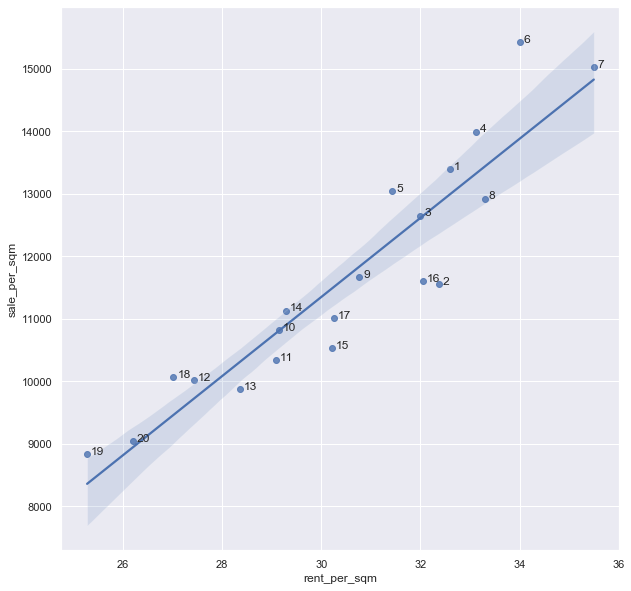

In [67]:
# scatter plot rent vs sales
sns.set(rc={'figure.figsize':(10,10)})
g =sns.regplot(x="rent_per_sqm", y="sale_per_sqm", 
              data=dis_ren_pop_df)
g.set(xscale="linear")

#add district label
for i, point in dfd.iterrows():
    g.text(point['rent_per_sqm']+.08, point['sale_per_sqm'], point['district'].astype(str)[:-2])
          

plt.show()


## Mapping Neighborhood surface

In [68]:
geo = json.load(open("quartier_paris.geojson"))
#create list from Json 
[dist["properties"]["l_qu"] for dist in geo["features"]]
#### explore json
geo.keys()
geo['type']
len(geo['type'])
type(geo['type'])
len(geo["features"])
geo["features"][0].keys()
geo["features"][0]['type']
geo["features"][0]['properties']
geo["features"][0]['geometry']
geo["features"][0]['type']

'Feature'

In [69]:
geo.keys() 

dict_keys(['type', 'features'])

In [70]:
geo['type']

'FeatureCollection'

In [71]:
#### create list from Json 
[dist["properties"]["l_qu"] for dist in geo["features"]]

#### create pandas DF from json
df2 = pd.DataFrame({
    "district" : [dist["properties"]["l_qu"] for dist in geo["features"]], 
    "surface" : [dist["properties"]["surface"] for dist in geo["features"]]
})
df2

,district,surface
0,Saint-Merri,3.130404e+05
1,Notre-Dame,3.782522e+05
2,Gros-Caillou,1.381893e+06
3,Notre-Dame-des-Champs,8.613070e+05
4,Petit-Montrouge,1.345774e+06
...,...,...
75,Saint-Vincent-de-Paul,9.268652e+05
76,Saint-Ambroise,8.379929e+05
77,Bel-Air,5.970921e+06
78,Montparnasse,1.126205e+06


In [72]:
paris = folium.Map(location = [48.856578, 2.351828], zoom_start = 12, tiles = 'Cartodb Positron')
folium.Choropleth(geo_data = geo, key_on = "feature.properties.l_qu",
                 data = df2, columns = ["district", "surface"],
                 fill_color = "Blues" 
                 ).add_to(paris)
paris


## Explore neighborhoods

In [73]:
#Import required libraries
#!conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans


In [74]:
# Foursquare credintials

CLIENT_ID = 'XEXTEEZDBW1A43JERYAHXMWQWGBKPJCHYBIUOHDJ5TU0SZJU' # your Foursquare ID
CLIENT_SECRET = 'TGFKZIOALCBIY4C4TLIUSFQMUDREJCNLGIQEFZJ5D2QMRSJF' # your Foursquare Secret
ACCESS_TOKEN= 'YHZ4TM4V10YGSSL1LIWS5LVSHOYTSAQMYPNHY5LD1MQO0JAL' # your Foursquare oauth2 token https://developer.foursquare.com/docs/api/configuration/authentication

VERSION = '20180604'

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XEXTEEZDBW1A43JERYAHXMWQWGBKPJCHYBIUOHDJ5TU0SZJU
CLIENT_SECRET:TGFKZIOALCBIY4C4TLIUSFQMUDREJCNLGIQEFZJ5D2QMRSJF


In [75]:
#map center (alternative method)

address = 'Paris, France'

geolocator = Nominatim(user_agent="explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Paris are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Paris are 48.8566969, 2.3514616.


Explore first neighborhood

In [76]:
newdis_df.loc[0, 'neighborhood']

'Saint-Merri'

In [77]:
neighbourhood_latitude = newdis_df.loc[0, 'lat'] # neighborhood latitude value
neighbourhood_longitude = newdis_df.loc[0, 'lon'] # neighborhood longitude value

neighbourhood_name = newdis_df.loc[0, 'neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighbourhood_name, 
                                                               neighbourhood_latitude, 
                                                               neighbourhood_longitude))

Latitude and longitude values of Saint-Merri are 48.85852137229997, 2.3516669671399995.


get the top 100 popular venues within 500m

In [78]:
LIMIT=100
radius=500
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighbourhood_latitude, 
    neighbourhood_longitude, 
    radius, 
    LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=XEXTEEZDBW1A43JERYAHXMWQWGBKPJCHYBIUOHDJ5TU0SZJU&client_secret=TGFKZIOALCBIY4C4TLIUSFQMUDREJCNLGIQEFZJ5D2QMRSJF&v=20180604&ll=48.85852137229997,2.3516669671399995&radius=500&limit=100'

In [79]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5ec93d4983525f001b4440d4'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Hôtel-de-Ville',
  'headerFullLocation': 'Hôtel-de-Ville, Paris',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 86,
  'suggestedBounds': {'ne': {'lat': 48.86302137679997,
    'lng': 2.358493934448836},
   'sw': {'lat': 48.854021367799966, 'lng': 2.344839999831163}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4bf41231e5eba59334341f90',
       'name': "Place de l'Hôtel de Ville – Esplanade de la Libération",
       'location': {'address': "Place de l'Hôtel de Ville",
        'lat': 48.85692475726913,
        'lng': 2.3514118156673676,
        'dista

Create function to get category of the venue. Then clean the data and create pandas dataframe.¶

In [80]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [81]:
venues = results['response']['groups'][0]['items']
venues

[{'reasons': {'count': 0,
   'items': [{'summary': 'This spot is popular',
     'type': 'general',
     'reasonName': 'globalInteractionReason'}]},
  'venue': {'id': '4bf41231e5eba59334341f90',
   'name': "Place de l'Hôtel de Ville – Esplanade de la Libération",
   'location': {'address': "Place de l'Hôtel de Ville",
    'lat': 48.85692475726913,
    'lng': 2.3514118156673676,
    'distance': 178,
    'postalCode': '75004',
    'cc': 'FR',
    'city': 'Paris',
    'state': 'Île-de-France',
    'country': 'France',
    'formattedAddress': ["Place de l'Hôtel de Ville",
     '75004 Paris',
     'France']},
   'categories': [{'id': '4bf58dd8d48988d164941735',
     'name': 'Plaza',
     'pluralName': 'Plazas',
     'shortName': 'Plaza',
     'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/plaza_',
      'suffix': '.png'},
     'primary': True}],
   'photos': {'count': 0, 'groups': []}},
  'referralId': 'e-0-4bf41231e5eba59334341f90-0'},
 {'reasons': {'count': 0,
  

In [82]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues

C:\Users\walter\anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  This is separate from the ipykernel package so we can avoid doing imports until


,name,categories,lat,lng
0,Place de l'Hôtel de Ville – Esplanade de la Li...,Plaza,48.856925,2.351412
1,Fleux',Furniture / Home Store,48.858763,2.354161
2,Librairie Flammarion,Bookstore,48.860270,2.352148
3,Huygens Cosmetique Naturelle Sur Mesure,Cosmetics Shop,48.858938,2.353778
4,L'Alsacien,Alsatian Restaurant,48.858275,2.350381
...,...,...,...,...
81,Huré,Bakery,48.854821,2.350112
82,Chez Julien,French Restaurant,48.854725,2.355124
83,Café Louis-Philippe,French Restaurant,48.854620,2.354770
84,Le Parvis,French Restaurant,48.854819,2.350063


In [83]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

86 venues were returned by Foursquare.


Repeat the process for all neighborhoods

In [ ]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)


Run the above function on each neighborhood and create a new dataframe called S_venues

In [ ]:
S_venues = getNearbyVenues(names=newdis_df['neighborhood'],
                                   latitudes=newdis_df['lat'],
                                   longitudes=newdis_df['lon']
                                  )

Record dataframe to file and check size of the data

In [ ]:
S_venues.to_csv(r'C:\Users\walter\Downloads\Python\Notebooks\COURSERA_CAPSTONE\S_venues_dataframe.csv', index = False, header=True)
print(S_venues.shape)

## Read venue data from file


In [248]:
S_venues = pd.read_csv(r'C:\Users\walter\Downloads\Python\Notebooks\COURSERA_CAPSTONE\S_venues_dataframe.csv')
S_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Saint-Merri,48.858521,2.351667,Place de l'Hôtel de Ville – Esplanade de la Li...,48.856925,2.351412,Plaza
1,Saint-Merri,48.858521,2.351667,Fleux',48.858763,2.354161,Furniture / Home Store
2,Saint-Merri,48.858521,2.351667,Librairie Flammarion,48.860270,2.352148,Bookstore
3,Saint-Merri,48.858521,2.351667,Huygens Cosmetique Naturelle Sur Mesure,48.858938,2.353778,Cosmetics Shop
4,Saint-Merri,48.858521,2.351667,L'Alsacien,48.858275,2.350381,Alsatian Restaurant


In [249]:
S_venues.groupby('Neighborhood').count() # Check the number of venues in dataset

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Amérique,14,14,14,14,14,14
Archives,100,100,100,100,100,100
Arsenal,65,65,65,65,65,65
Arts-et-Metiers,100,100,100,100,100,100
Auteuil,16,16,16,16,16,16
Batignolles,100,100,100,100,100,100
Bel-Air,5,5,5,5,5,5
Belleville,44,44,44,44,44,44
Bercy,71,71,71,71,71,71


find out how many unique categories of venues is there from all the returned venues

In [250]:
print('There are {} uniques categories.'.format(len(S_venues['Venue Category'].unique())))

There are 296 uniques categories.


### Is there a relationship between number of venues and real estate value ? 

In [251]:
numberofven= S_venues.groupby('Neighborhood').count().reset_index()
numberofven

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Amérique,14,14,14,14,14,14
1,Archives,100,100,100,100,100,100
2,Arsenal,65,65,65,65,65,65
3,Arts-et-Metiers,100,100,100,100,100,100
4,Auteuil,16,16,16,16,16,16
5,Batignolles,100,100,100,100,100,100
6,Bel-Air,5,5,5,5,5,5
7,Belleville,44,44,44,44,44,44
8,Bercy,71,71,71,71,71,71
9,Bonne-Nouvelle,100,100,100,100,100,100


In [252]:
numberofvenues=pd.concat([numberofven[['Neighborhood']],numberofven[['Venue']]], axis=1)
numberofvenues

,Neighborhood,Venue
0,Amérique,14
1,Archives,100
2,Arsenal,65
3,Arts-et-Metiers,100
4,Auteuil,16
5,Batignolles,100
6,Bel-Air,5
7,Belleville,44
8,Bercy,71
9,Bonne-Nouvelle,100


In [253]:
numberofvenues_rent=pd.concat([df1,numberofvenues], axis=1)
numberofvenues_rent

,neighborhood_n,rent_per_sqm,Neighborhood,Venue
0,13,33.500000,Amérique,14
1,16,33.500000,Archives,100
2,28,35.500000,Arsenal,65
3,23,35.500000,Arts-et-Metiers,100
4,55,29.740625,Auteuil,16
5,74,24.718750,Batignolles,100
6,62,32.675000,Bel-Air,5
7,64,32.675000,Belleville,44
8,68,28.421875,Bercy,71
9,36,29.846875,Bonne-Nouvelle,100


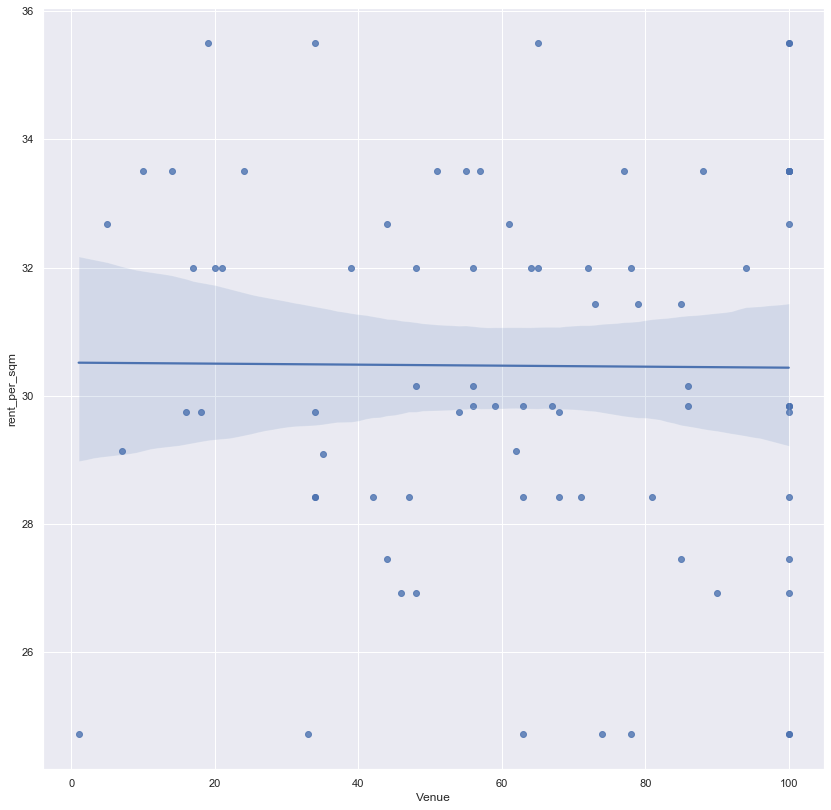

In [254]:
# scatter plot rent vs sales
sns.set(rc={'figure.figsize':(14,14)})
f =sns.regplot(x="Venue", y="rent_per_sqm", 
              data=numberofvenues_rent)
f.set(xscale="linear")

plt.show()
           


Rent does not depend on the number of venues in a neighborhood.

Let's analyze each neighborhood

One Hot encoding

In [255]:
# one hot encoding
Paris_onehot = pd.get_dummies(S_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
Paris_onehot['Neighborhood'] = S_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [Paris_onehot.columns[-1]] + list(Paris_onehot.columns[:-1])
Paris_onehot = Paris_onehot[fixed_columns]

Paris_onehot.head()

,Neighborhood,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,Saint-Merri,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Saint-Merri,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Saint-Merri,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Saint-Merri,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Saint-Merri,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [256]:
Paris_onehot.shape # Let's examine the size of data

(5032, 297)

,Neighborhood,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,Amérique,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Archives,0,0,0,0,0,0,0,0,4,...,1,0,0,0,1,0,0,0,0,0
2,Arsenal,0,0,0,0,0,0,0,0,0,...,2,0,0,0,1,0,0,0,0,0
3,Arts-et-Metiers,0,0,0,0,0,0,0,1,2,...,2,0,0,3,5,2,0,0,0,0
4,Auteuil,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,Batignolles,0,0,0,0,1,0,0,0,0,...,1,0,0,0,1,0,0,0,0,0
6,Bel-Air,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,Belleville,0,0,1,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,0,0
8,Bercy,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
9,Bonne-Nouvelle,0,0,0,0,0,0,0,0,0,...,1,0,0,0,6,1,2,1,0,0


In [317]:
venueslist=list(Paris_onehot.columns) # create list of venues in dataframe

## Grouping by neighborhood based on SUM of all venues

In [258]:
## Grouping by neighborhood based on SUM of all venues

paris_grouped = Paris_onehot.groupby('Neighborhood').sum().reset_index()
paris_grouped

,Neighborhood,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,Amérique,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Archives,0,0,0,0,0,0,0,0,4,...,1,0,0,0,1,0,0,0,0,0
2,Arsenal,0,0,0,0,0,0,0,0,0,...,2,0,0,0,1,0,0,0,0,0
3,Arts-et-Metiers,0,0,0,0,0,0,0,1,2,...,2,0,0,3,5,2,0,0,0,0
4,Auteuil,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,Batignolles,0,0,0,0,1,0,0,0,0,...,1,0,0,0,1,0,0,0,0,0
6,Bel-Air,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,Belleville,0,0,1,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,0,0
8,Bercy,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
9,Bonne-Nouvelle,0,0,0,0,0,0,0,0,0,...,1,0,0,0,6,1,2,1,0,0


In [259]:
paris_grouped.shape # Check shape to see if number of columns intact

(80, 297)

In [260]:
# select numeric columns and calculate the sums
sums = paris_grouped.select_dtypes(pd.np.number).sum().rename('total')

# append sums to the data frameparis_grouped.append(sums)
partot = paris_grouped.append(sums) #add sum line
partot.loc['total', 'Neighborhood']='All districts' #rename sum line 'All districts'
partot.set_index('Neighborhood', inplace=True) # use 'Neighborhood' column as index
# Sort columns of a dataframe in descending order based on 'All districts' line
partot = partot.sort_values(by='All districts', axis=1, ascending=False)
partot['Total venues'] = partot.sum(axis=1) # add 'Total Venues' column
partot = partot.sort_values(by='Total venues', axis=0, ascending=False) # sort rows in descending order based on 'Total Venues
partot=partot.transpose() #Transpose

partot


C:\Users\walter\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  


Neighborhood,All districts,Champs-Elysées,Folie-Méricourt,Hôpital-Saint-Louis,Mail,Archives,Notre-Dame-des-Champs,Palais-Royal,Place-Vendôme,Gros-Caillou,...,Saint-Fargeau,Ecole-Militaire,La Chapelle,Salpêtrière,Auteuil,Amérique,Porte-Dauphine,Muette,Bel-Air,Picpus
French Restaurant,696.0,15.0,12.0,17.0,10.0,9.0,19.0,9.0,14.0,26.0,...,1.0,3.0,2.0,2.0,1.0,2.0,0.0,2.0,1.0,0.0
Hotel,408.0,10.0,2.0,2.0,3.0,8.0,10.0,6.0,12.0,9.0,...,0.0,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
Italian Restaurant,201.0,5.0,2.0,3.0,1.0,4.0,4.0,8.0,3.0,11.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
Bar,157.0,0.0,8.0,10.0,3.0,4.0,0.0,1.0,0.0,1.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
Bakery,138.0,1.0,6.0,1.0,5.0,1.0,7.0,2.0,0.0,3.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Japanese Restaurant,137.0,4.0,2.0,2.0,1.0,3.0,5.0,11.0,4.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Café,124.0,2.0,1.0,4.0,0.0,1.0,2.0,0.0,0.0,5.0,...,2.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
Bistro,120.0,2.0,2.0,3.0,2.0,4.0,4.0,0.0,0.0,3.0,...,0.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
Plaza,115.0,3.0,0.0,2.0,1.0,3.0,0.0,5.0,2.0,1.0,...,3.0,2.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0
Coffee Shop,91.0,1.0,1.0,4.0,2.0,5.0,0.0,2.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Keep top 20 venues for clustering analysis

In [261]:
heat = partot.transpose().copy()
heat =  heat[heat.columns[0:20]] #keep 20 top venues
heat.drop(index='All districts', inplace=True)
topvenueslist=list(heat.columns) # create list with top venues
heat

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
Neighborhood,,,,,,,,,,,,,,,,,,,,
Champs-Elysées,15.0,10.0,5.0,0.0,1.0,4.0,2.0,2.0,3.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0,4.0,0.0,0.0
Folie-Méricourt,12.0,2.0,2.0,8.0,6.0,2.0,1.0,2.0,0.0,1.0,4.0,7.0,1.0,5.0,2.0,1.0,0.0,0.0,0.0,2.0
Hôpital-Saint-Louis,17.0,2.0,3.0,10.0,1.0,2.0,4.0,3.0,2.0,4.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,2.0,1.0,1.0
Mail,10.0,3.0,1.0,3.0,5.0,1.0,0.0,2.0,1.0,2.0,5.0,1.0,7.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0
Archives,9.0,8.0,4.0,4.0,1.0,3.0,1.0,4.0,3.0,5.0,1.0,2.0,3.0,2.0,2.0,0.0,0.0,2.0,1.0,1.0
Notre-Dame-des-Champs,19.0,10.0,4.0,0.0,7.0,5.0,2.0,4.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,1.0
Palais-Royal,9.0,6.0,8.0,1.0,2.0,11.0,0.0,0.0,5.0,2.0,3.0,1.0,1.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0
Place-Vendôme,14.0,12.0,3.0,0.0,0.0,4.0,0.0,0.0,2.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
Gros-Caillou,26.0,9.0,11.0,1.0,3.0,1.0,5.0,3.0,1.0,2.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,2.0,3.0,2.0


In [262]:
topvenueslist

['French Restaurant',
 'Hotel',
 'Italian Restaurant',
 'Bar',
 'Bakery',
 'Japanese Restaurant',
 'Café',
 'Bistro',
 'Plaza',
 'Coffee Shop',
 'Wine Bar',
 'Restaurant',
 'Cocktail Bar',
 'Pizza Place',
 'Sandwich Place',
 'Supermarket',
 'Park',
 'Garden',
 'Ice Cream Shop',
 'Burger Joint']

In [263]:
heat.describe()

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
count,80.000000,80.000000,80.000000,80.000000,80.00000,80.000000,80.00000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.00000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000
mean,8.700000,5.100000,2.512500,1.962500,1.72500,1.712500,1.55000,1.500000,1.437500,1.137500,1.125000,1.012500,0.987500,0.97500,0.675000,0.675000,0.612500,0.575000,0.562500,0.562500
std,5.560712,4.315412,2.349219,2.378404,1.63796,2.165283,1.28181,1.475539,1.430621,1.280266,1.461532,1.277792,1.634236,1.04306,0.951681,0.924696,0.787461,0.868215,1.088998,0.690693
min,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.750000,2.000000,1.000000,0.000000,0.00000,0.000000,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,9.000000,5.000000,2.000000,1.000000,1.50000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,12.000000,8.000000,3.250000,3.000000,3.00000,2.250000,2.00000,2.000000,2.000000,2.000000,2.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,26.000000,21.000000,11.000000,10.000000,7.00000,13.000000,5.00000,5.000000,5.000000,6.000000,6.000000,7.000000,8.000000,5.00000,5.000000,4.000000,3.000000,4.000000,6.000000,3.000000


In [349]:
descriptor_df = heat.describe()
descriptor_df

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
count,80.000000,80.000000,80.000000,80.000000,80.00000,80.000000,80.00000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.00000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000
mean,8.700000,5.100000,2.512500,1.962500,1.72500,1.712500,1.55000,1.500000,1.437500,1.137500,1.125000,1.012500,0.987500,0.97500,0.675000,0.675000,0.612500,0.575000,0.562500,0.562500
std,5.560712,4.315412,2.349219,2.378404,1.63796,2.165283,1.28181,1.475539,1.430621,1.280266,1.461532,1.277792,1.634236,1.04306,0.951681,0.924696,0.787461,0.868215,1.088998,0.690693
min,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.750000,2.000000,1.000000,0.000000,0.00000,0.000000,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,9.000000,5.000000,2.000000,1.000000,1.50000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,12.000000,8.000000,3.250000,3.000000,3.00000,2.250000,2.00000,2.000000,2.000000,2.000000,2.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,26.000000,21.000000,11.000000,10.000000,7.00000,13.000000,5.00000,5.000000,5.000000,6.000000,6.000000,7.000000,8.000000,5.00000,5.000000,4.000000,3.000000,4.000000,6.000000,3.000000


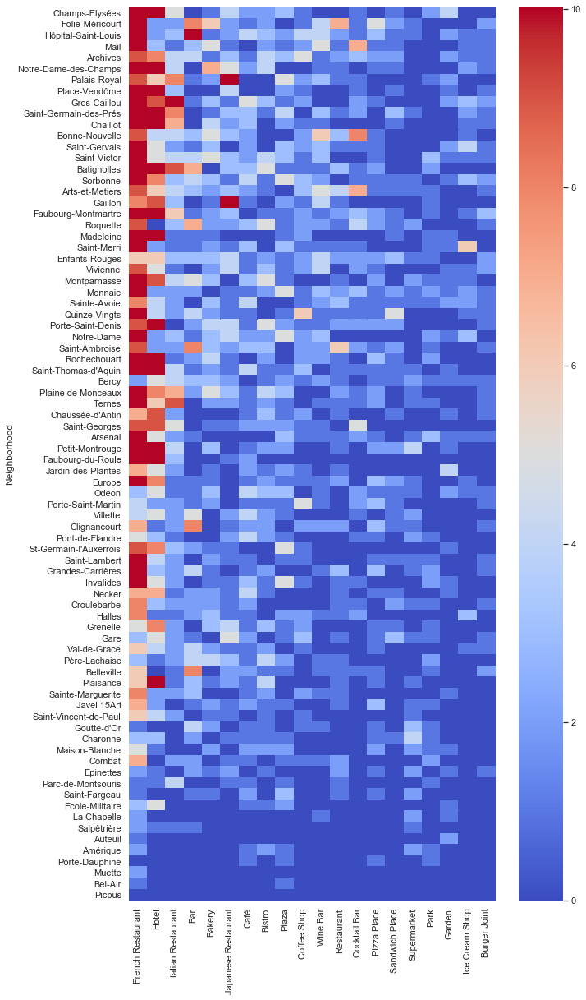

In [411]:
sns.set(rc={'figure.figsize':(10,20)})
sns.heatmap(heat, cmap='coolwarm',  robust = True)
plt.show()


# Clustering of neighborhood from location data 
REFRESH FROM HERE

In [266]:
paris_grouped.reset_index(drop=True, inplace=True)

In [412]:
rent_df_neighborhoods.sort_values('neighborhood', inplace=True)
rent_df_neighborhoods.reset_index(drop=True, inplace=True)

In [413]:
heat_rent = pd.concat([paris_grouped, rent_df_neighborhoods], axis=1)
heat_rent

,Neighborhood,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Zoo,Zoo Exhibit,neighborhood,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
0,Amérique,0,0,0,0,0,0,0,0,0,...,0,0,Amérique,75.0,2.5,0.5,24.718750,2017.0,48.881638,2.395440
1,Archives,0,0,0,0,0,0,0,0,4,...,0,0,Archives,11.0,2.5,0.5,31.996875,2017.0,48.859192,2.363205
2,Arsenal,0,0,0,0,0,0,0,0,0,...,0,0,Arsenal,15.0,2.5,0.5,33.500000,2017.0,48.851585,2.364768
3,Arts-et-Metiers,0,0,0,0,0,0,0,1,2,...,0,0,Arts-et-Metiers,9.0,2.5,0.5,31.996875,2017.0,48.866470,2.357083
4,Auteuil,0,0,0,0,0,0,0,0,0,...,0,0,Auteuil,61.0,2.5,0.5,30.156250,2017.0,48.850622,2.252277
5,Batignolles,0,0,0,0,1,0,0,0,0,...,0,0,Batignolles,67.0,2.5,0.5,29.740625,2017.0,48.888482,2.313856
6,Bel-Air,0,0,0,0,0,0,0,0,0,...,0,0,Bel-Air,45.0,2.5,0.5,26.921875,2017.0,48.837996,2.433178
7,Belleville,0,0,1,0,0,0,0,0,0,...,0,0,Belleville,77.0,2.5,0.5,28.421875,2017.0,48.871531,2.387549
8,Bercy,0,0,0,0,0,0,0,0,0,...,0,0,Bercy,47.0,2.5,0.5,26.921875,2017.0,48.835209,2.386210
9,Bonne-Nouvelle,0,0,0,0,0,0,0,0,0,...,0,0,Bonne-Nouvelle,8.0,2.5,0.5,31.996875,2017.0,48.867150,2.350080


In [414]:
### venue_rent= heat_rent[topvenueslist+['Neighborhood', 'rent_per_sqm']].set_index("Neighborhood")
venue_rent= heat_rent[topvenueslist+['Neighborhood']].set_index("Neighborhood")
venue_rent

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
Neighborhood,,,,,,,,,,,,,,,,,,,,
Amérique,2,0,0,0,0,0,1,2,1,0,0,0,0,0,0,2,1,0,0,0
Archives,9,8,4,4,1,3,1,4,3,5,1,2,3,2,2,0,0,2,1,1
Arsenal,12,5,2,1,0,0,0,0,3,1,1,1,2,1,0,1,3,1,1,1
Arts-et-Metiers,9,6,4,3,2,3,2,1,0,3,5,4,7,1,1,1,1,0,0,1
Auteuil,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0
Batignolles,20,12,9,7,0,3,3,5,1,1,1,3,1,2,0,0,2,0,0,0
Bel-Air,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
Belleville,6,0,1,8,0,2,2,1,1,0,1,1,1,1,0,0,1,0,0,2
Bercy,2,5,4,3,3,2,0,1,2,1,2,1,0,1,1,2,1,1,1,1


k-mean Clustering using location data (sum) 

In [415]:
from sklearn.cluster import KMeans

# set number of clusters
kclusters = 4


# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=2).fit(venue_rent)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:] 

array([2, 3, 1, 1, 2, 0, 2, 1, 2, 1, 0, 0, 2, 3, 1, 2, 3, 2, 3, 2, 0, 0,
       0, 1, 3, 3, 2, 1, 3, 0, 1, 1, 0, 3, 2, 2, 0, 1, 2, 1, 0, 2, 3, 1,
       0, 2, 3, 2, 3, 2, 0, 3, 3, 2, 2, 3, 2, 2, 1, 0, 1, 1, 2, 3, 0, 1,
       3, 1, 0, 0, 2, 3, 1, 2, 3, 3, 0, 3, 3, 3])

In [416]:
clustering_with_rent=kmeans.labels_[0:] 

In [417]:
# add clustering labels
venue_rent.insert(0, 'Cluster Labels', kmeans.labels_)

In [418]:
venue_rent

,Cluster Labels,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,...,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
Neighborhood,,,,,,,,,,,,,,,,,,,,,
Amérique,2,2,0,0,0,0,0,1,2,1,...,0,0,0,0,0,2,1,0,0,0
Archives,3,9,8,4,4,1,3,1,4,3,...,1,2,3,2,2,0,0,2,1,1
Arsenal,1,12,5,2,1,0,0,0,0,3,...,1,1,2,1,0,1,3,1,1,1
Arts-et-Metiers,1,9,6,4,3,2,3,2,1,0,...,5,4,7,1,1,1,1,0,0,1
Auteuil,2,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,0,0
Batignolles,0,20,12,9,7,0,3,3,5,1,...,1,3,1,2,0,0,2,0,0,0
Bel-Air,2,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
Belleville,1,6,0,1,8,0,2,2,1,1,...,1,1,1,1,0,0,1,0,0,2
Bercy,2,2,5,4,3,3,2,0,1,2,...,2,1,0,1,1,2,1,1,1,1


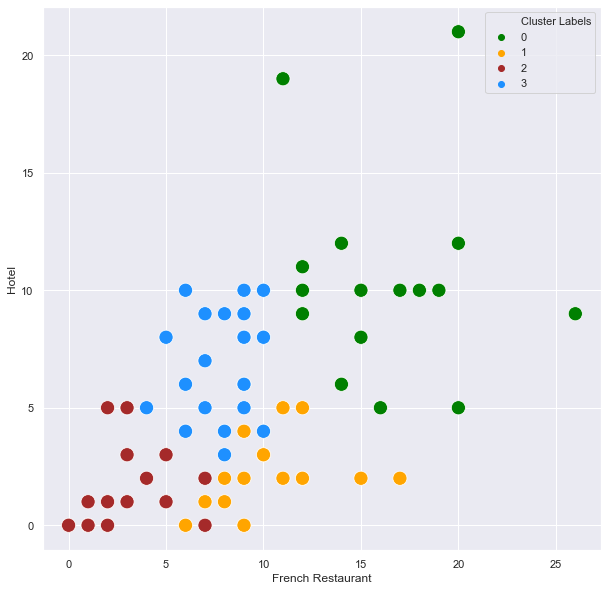

In [419]:

sns.set(rc={'figure.figsize':(10,10)})
g =sns.scatterplot(x="French Restaurant", y="Hotel", hue="Cluster Labels",
              data=venue_rent, 
              palette=['green','orange','brown','dodgerblue'], legend='full', s=200)
g.set(xscale="linear")

plt.show()

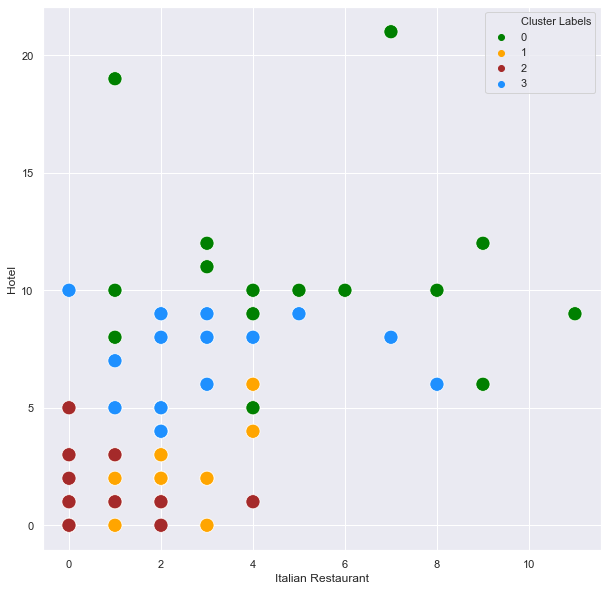

In [420]:

sns.set(rc={'figure.figsize':(10,10)})
g =sns.scatterplot(x="Italian Restaurant", y="Hotel", hue="Cluster Labels",
              data=venue_rent, 
              palette=['green','orange','brown','dodgerblue'], legend='full', s=200)
g.set(xscale="linear")

plt.show()

In [276]:
centeroids = venue_rent.groupby("Cluster Labels").mean()
centeroids

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
Cluster Labels,,,,,,,,,,,,,,,,,,,,
0,16.411765,10.411765,4.823529,1.352941,2.176471,2.000000,2.000000,1.941176,1.588235,1.058824,0.823529,0.823529,0.764706,1.058824,0.764706,0.352941,0.882353,0.705882,0.705882,0.647059
1,10.277778,2.555556,2.166667,4.277778,2.111111,1.444444,1.722222,1.500000,1.500000,1.944444,2.555556,2.111111,2.277778,1.388889,0.888889,0.500000,0.722222,0.500000,1.277778,0.833333
2,2.739130,1.478261,0.826087,0.956522,0.913043,0.608696,1.000000,0.913043,1.000000,0.391304,0.347826,0.391304,0.217391,0.695652,0.173913,1.086957,0.565217,0.391304,0.086957,0.173913
3,7.681818,6.863636,2.772727,1.590909,1.909091,2.863636,1.636364,1.772727,1.727273,1.318182,1.000000,0.909091,0.909091,0.863636,0.954545,0.636364,0.363636,0.727273,0.363636,0.681818


<Figure size 720x720 with 0 Axes>

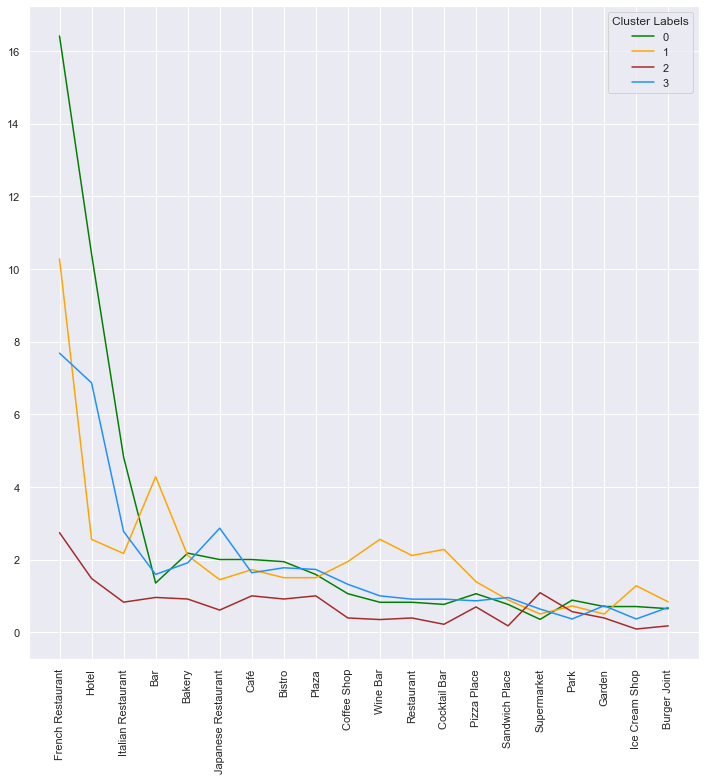

In [277]:
plt.clf()
ct=centeroids.transpose()
ct.plot(kind='line', figsize=(12,12), color=['green','orange','brown','dodgerblue'])
plt.xticks(range(len(ct.index)), ct.index, rotation=90)

plt.show()

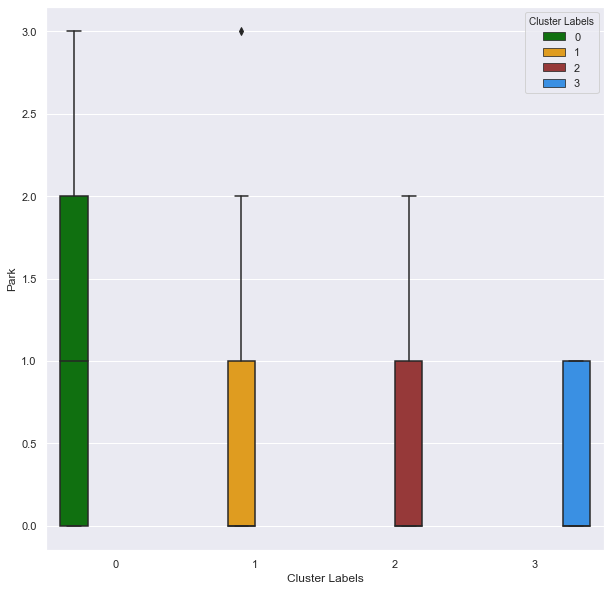

In [278]:
ax = sns.boxplot(x="Cluster Labels", y="Park", hue="Cluster Labels",
                 data=venue_rent, palette=['green','orange','brown','dodgerblue'])

Create Pandas dataframe for the above

In [279]:
# Sort data in descending order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [280]:
# Creating new data frame with top 20 venues
num_top_venues = 20

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = paris_grouped['Neighborhood']

for ind in np.arange(paris_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,Amérique,French Restaurant,Supermarket,Bistro,Plaza,Pool,Bed & Breakfast,Café,Park,Health Food Store,...,Smoke Shop,Exhibit,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Eastern European Restaurant,Farmers Market,Fast Food Restaurant,Fish & Chips Shop
1,Archives,French Restaurant,Hotel,Coffee Shop,Italian Restaurant,Art Gallery,Bistro,Bar,Japanese Restaurant,Plaza,...,Tapas Restaurant,Cocktail Bar,Pizza Place,Historic Site,Sandwich Place,Restaurant,Gourmet Shop,Bookstore,Deli / Bodega,Garden
2,Arsenal,French Restaurant,Hotel,Park,Seafood Restaurant,Plaza,Italian Restaurant,Gastropub,Boat or Ferry,Pedestrian Plaza,...,Cocktail Bar,Vegetarian / Vegan Restaurant,Spa,Garden,Szechuan Restaurant,Supermarket,Beer Store,Coffee Shop,Pizza Place,Pub
3,Arts-et-Metiers,French Restaurant,Cocktail Bar,Hotel,Wine Bar,Italian Restaurant,Restaurant,Bar,Coffee Shop,Vietnamese Restaurant,...,Chinese Restaurant,Moroccan Restaurant,Café,Theater,Steakhouse,Art Gallery,Seafood Restaurant,Vegetarian / Vegan Restaurant,Wine Shop,Bakery
4,Auteuil,Tennis Court,Garden,Stadium,Sporting Goods Shop,Outdoors & Recreation,Botanical Garden,Racecourse,Museum,French Restaurant,...,English Restaurant,Ethiopian Restaurant,Exhibit,Fast Food Restaurant,Falafel Restaurant,Farmers Market,Electronics Store,Fish & Chips Shop,Fish Market,Flea Market


### k-mean Clustering using location data (sum) without rent data

from sklearn.cluster import KMeans

# set number of clusters
kclusters = 4

paris_cluster = paris_grouped.drop("Neighborhood", 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=1).fit(paris_cluster)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:] 

clustering_wo_rent=kmeans.labels_[0:] 

clustering_with_rent


clustering_wo_rent

sns.set(rc={'figure.figsize':(10,10)})
g1 =sns.scatterplot(x=clustering_with_rent, y=clustering_wo_rent)

Create a new data frame to include clusters

In [281]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

In [282]:
pd.set_option('display.max_rows', None)
neighborhoods_venues_sorted

,Cluster Labels,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,2,Amérique,French Restaurant,Supermarket,Bistro,Plaza,Pool,Bed & Breakfast,Café,Park,...,Smoke Shop,Exhibit,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Eastern European Restaurant,Farmers Market,Fast Food Restaurant,Fish & Chips Shop
1,3,Archives,French Restaurant,Hotel,Coffee Shop,Italian Restaurant,Art Gallery,Bistro,Bar,Japanese Restaurant,...,Tapas Restaurant,Cocktail Bar,Pizza Place,Historic Site,Sandwich Place,Restaurant,Gourmet Shop,Bookstore,Deli / Bodega,Garden
2,1,Arsenal,French Restaurant,Hotel,Park,Seafood Restaurant,Plaza,Italian Restaurant,Gastropub,Boat or Ferry,...,Cocktail Bar,Vegetarian / Vegan Restaurant,Spa,Garden,Szechuan Restaurant,Supermarket,Beer Store,Coffee Shop,Pizza Place,Pub
3,1,Arts-et-Metiers,French Restaurant,Cocktail Bar,Hotel,Wine Bar,Italian Restaurant,Restaurant,Bar,Coffee Shop,...,Chinese Restaurant,Moroccan Restaurant,Café,Theater,Steakhouse,Art Gallery,Seafood Restaurant,Vegetarian / Vegan Restaurant,Wine Shop,Bakery
4,2,Auteuil,Tennis Court,Garden,Stadium,Sporting Goods Shop,Outdoors & Recreation,Botanical Garden,Racecourse,Museum,...,English Restaurant,Ethiopian Restaurant,Exhibit,Fast Food Restaurant,Falafel Restaurant,Farmers Market,Electronics Store,Fish & Chips Shop,Fish Market,Flea Market
5,0,Batignolles,French Restaurant,Hotel,Italian Restaurant,Bar,Bistro,Restaurant,Café,Japanese Restaurant,...,Park,Pizza Place,Coffee Shop,Mediterranean Restaurant,Sushi Restaurant,Pastry Shop,Lebanese Restaurant,Liquor Store,Brasserie,Breakfast Spot
6,2,Bel-Air,Plaza,Playground,Sports Club,French Restaurant,Recreation Center,Zoo Exhibit,Farmers Market,Electronics Store,...,Ethiopian Restaurant,Exhibit,Falafel Restaurant,Fish Market,Fast Food Restaurant,Fish & Chips Shop,Donut Shop,Flea Market,Flower Shop,Fondue Restaurant
7,1,Belleville,Bar,French Restaurant,Japanese Restaurant,Burger Joint,Café,Italian Restaurant,Chinese Restaurant,Beer Store,...,Bookstore,Restaurant,Plaza,Thai Restaurant,Pizza Place,Concert Hall,Photography Studio,Park,Diner,Music Venue
8,2,Bercy,Hotel,Italian Restaurant,Bakery,Bar,French Restaurant,Wine Bar,Pastry Shop,Supermarket,...,Plaza,Museum,Cambodian Restaurant,Candy Store,Sandwich Place,Miscellaneous Shop,Shopping Plaza,Flea Market,Bus Stop,Bus Station
9,1,Bonne-Nouvelle,French Restaurant,Cocktail Bar,Wine Bar,Bakery,Hotel,Italian Restaurant,Bar,Japanese Restaurant,...,Pastry Shop,Café,Women's Store,Optical Shop,Pedestrian Plaza,Tea Room,Speakeasy,Spa,Souvlaki Shop,Pizza Place


In [283]:
#rename column to match FourSquare format
newdis_df.rename(columns = {'neighborhood':'Neighborhood'}, inplace = True)

In [284]:
#keep the ones required
par=newdis_df[['Neighborhood','lat','lon']]
par

,Neighborhood,lat,lon
0,Saint-Merri,48.858521,2.351667
1,Notre-Dame,48.852896,2.352775
2,Gros-Caillou,48.858300,2.301542
3,Notre-Dame-des-Champs,48.846428,2.327357
4,Petit-Montrouge,48.826653,2.326437
5,Pont-de-Flandre,48.895556,2.384777
6,Muette,48.863275,2.259936
7,Chaillot,48.868434,2.291679
8,Epinettes,48.894943,2.321119
9,Rochechouart,48.879812,2.344861


In [285]:
# merge paris_grouped with clustered dataframe to add latitude/longitude for each neighborhood
P_merged = par

P_merged = P_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

P_merged.sort_values(by=['Cluster Labels']) # check the last columns!

,Neighborhood,lat,lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
31,Europe,48.878148,2.317175,0,French Restaurant,Hotel,Pizza Place,Bistro,Sandwich Place,Thai Restaurant,...,Salad Place,Chinese Restaurant,Pub,Plaza,Convenience Store,Pastry Shop,Sushi Restaurant,Music Store,Modern European Restaurant,Mobile Phone Shop
17,Saint-Thomas-d'Aquin,48.855263,2.325588,0,French Restaurant,Hotel,Café,Italian Restaurant,Coffee Shop,Cheese Shop,...,Tailor Shop,Bistro,Brasserie,Shoe Store,Sandwich Place,Salad Place,Candy Store,Restaurant,Cocktail Bar,Chocolate Shop
53,Saint-Victor,48.847664,2.354093,0,French Restaurant,Bakery,Hotel,Italian Restaurant,Bar,Bistro,...,Museum,Japanese Restaurant,Falafel Restaurant,Historic Site,Café,Diner,Miscellaneous Shop,Argentinian Restaurant,Portuguese Restaurant,Pool
54,Madeleine,48.871265,2.320053,0,Hotel,French Restaurant,Boutique,Women's Store,Gourmet Shop,Clothing Store,...,Salad Place,Hotel Bar,Corsican Restaurant,Russian Restaurant,Brasserie,Plaza,Sandwich Place,Modern European Restaurant,Cosmetics Shop,Park
13,Faubourg-Montmartre,48.873935,2.343253,0,French Restaurant,Hotel,Italian Restaurant,Vegetarian / Vegan Restaurant,Japanese Restaurant,Chinese Restaurant,...,Restaurant,Coffee Shop,Pizza Place,Creperie,Thai Restaurant,Dessert Shop,Bakery,Doner Restaurant,Empanada Restaurant,Seafood Restaurant
12,Invalides,48.858515,2.316445,0,French Restaurant,Plaza,Hotel,History Museum,Café,Park,...,Garden,Furniture / Home Store,Restaurant,Tea Room,Brasserie,Bakery,Coffee Shop,Cocktail Bar,Cafeteria,Kids Store
78,Montparnasse,48.837623,2.331784,0,French Restaurant,Hotel,Bar,Bistro,Italian Restaurant,Sushi Restaurant,...,Southwestern French Restaurant,Wine Shop,Lebanese Restaurant,Fountain,Bubble Tea Shop,Ice Cream Shop,Seafood Restaurant,Bus Stop,Indie Movie Theater,Cajun / Creole Restaurant
64,Faubourg-du-Roule,48.874136,2.304119,0,French Restaurant,Hotel,Jewelry Store,Italian Restaurant,Men's Store,Café,...,Cosmetics Shop,Seafood Restaurant,Spa,Comedy Club,Chocolate Shop,Clothing Store,Scandinavian Restaurant,Department Store,Concert Hall,Optical Shop
44,Champs-Elysées,48.867074,2.308652,0,French Restaurant,Hotel,Boutique,Italian Restaurant,Japanese Restaurant,Garden,...,Park,Café,Spa,Bistro,Historic Site,Women's Store,Creperie,Steakhouse,Cocktail Bar,Sporting Goods Shop
9,Rochechouart,48.879812,2.344861,0,French Restaurant,Hotel,Bakery,Pizza Place,Vegetarian / Vegan Restaurant,Park,...,Bistro,Eastern European Restaurant,Restaurant,Chocolate Shop,Spa,Record Shop,Beer Store,Sushi Restaurant,Beer Bar,Music Venue


In [286]:
P_merged.shape

(80, 24)

In [423]:
P_merged.to_csv(r'C:\Users\walter\Downloads\Python\Notebooks\COURSERA_CAPSTONE\P_merged.csv', index = False, header=True)

In [287]:
# Choropleth map of data with clusters 
paris = folium.Map(location=[latitude, longitude], zoom_start=12 , tiles = 'Cartodb Positron')


folium.Choropleth(
    geo_data = geo, 
    data = df,
    columns = ['district', 'rent_per_sqm'],
    key_on = 'feature.properties.c_qu',
    #fill_color='YlGn',
    fill_color='PuOr',
    #fill_opacity=0.8,
    #line_opacity=0.2,
    legend_name='Monthly Rent in Euro per square meter',

).add_to(paris)



folium.LayerControl().add_to(paris)


palette=['green','orange','brown','dodgerblue']

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(P_merged['lat'], P_merged['lon'], P_merged['Neighborhood'], P_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=palette[cluster],
        #color=plasma[cluster-1],
        fill=True,
        fill_color=palette[cluster],
        fill_opacity=0.7).add_to(paris)
paris

## Aggregating neighborhood location data per district

In [288]:
newdis_df # neighborhood data

,neighborhood_n,c_quinsee,neighborhood_name,district,perimetre,surface,geometry,Neighborhood,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
0,13,7510401,Saint-Merri,4,2346.004687,3.130404e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.352623...",Saint-Merri,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
1,16,7510404,Notre-Dame,4,3283.163371,3.782522e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.361313...",Notre-Dame,16.0,2.5,0.5,33.500000,2017.0,48.852896,2.352775
2,28,7510704,Gros-Caillou,7,4720.994373,1.381893e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.309544...",Gros-Caillou,28.0,2.5,0.5,35.500000,2017.0,48.858300,2.301542
3,23,7510603,Notre-Dame-des-Champs,6,4559.989773,8.613070e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.336756...",Notre-Dame-des-Champs,23.0,2.5,0.5,35.500000,2017.0,48.846428,2.327357
4,55,7511403,Petit-Montrouge,14,5490.636672,1.345774e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.329136...",Petit-Montrouge,55.0,2.5,0.5,29.740625,2017.0,48.826653,2.326437
5,74,7511902,Pont-de-Flandre,19,6397.871676,2.376238e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.384878...",Pont-de-Flandre,74.0,2.5,0.5,24.718750,2017.0,48.895556,2.384777
6,62,7511602,Muette,16,11962.438594,5.477898e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.245624...",Muette,62.0,2.5,0.5,32.675000,2017.0,48.863275,2.259936
7,64,7511604,Chaillot,16,5207.046446,1.424035e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.292681...",Chaillot,64.0,2.5,0.5,32.675000,2017.0,48.868434,2.291679
8,68,7511704,Epinettes,17,5171.706451,1.378545e+06,"{""type"": ""Polygon"", ""coordinates"": [[[2.325914...",Epinettes,68.0,2.5,0.5,28.421875,2017.0,48.894943,2.321119
9,36,7510904,Rochechouart,9,2862.450525,5.004354e+05,"{""type"": ""Polygon"", ""coordinates"": [[[2.349708...",Rochechouart,36.0,2.5,0.5,29.846875,2017.0,48.879812,2.344861


In [393]:
newdis_aggregated =  newdis_df.groupby('Neighborhood').mean().reset_index() # neighborhood data aggregated by neighborhood
newdis_aggregated

,Neighborhood,neighborhood_n,c_quinsee,district,perimetre,surface,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
0,Amérique,75,7511903,19,6399.022082,1.835720e+06,75.0,2.5,0.5,24.718750,2017.0,48.881638,2.395440
1,Archives,11,7510303,3,2534.100042,3.677284e+05,11.0,2.5,0.5,31.996875,2017.0,48.859192,2.363205
2,Arsenal,15,7510403,4,2878.559656,4.872649e+05,15.0,2.5,0.5,33.500000,2017.0,48.851585,2.364768
3,Arts-et-Metiers,9,7510301,3,2482.460453,3.180877e+05,9.0,2.5,0.5,31.996875,2017.0,48.866470,2.357083
4,Auteuil,61,7511601,16,12452.253931,6.383888e+06,61.0,2.5,0.5,30.156250,2017.0,48.850622,2.252277
5,Batignolles,67,7511703,17,5832.690026,1.441711e+06,67.0,2.5,0.5,29.740625,2017.0,48.888482,2.313856
6,Bel-Air,45,7511201,12,18427.822238,5.970921e+06,45.0,2.5,0.5,26.921875,2017.0,48.837996,2.433178
7,Belleville,77,7512001,20,3738.454432,8.065686e+05,77.0,2.5,0.5,28.421875,2017.0,48.871531,2.387549
8,Bercy,47,7511203,12,6155.005036,1.902932e+06,47.0,2.5,0.5,26.921875,2017.0,48.835209,2.386210
9,Bonne-Nouvelle,8,7510204,2,2233.976030,2.814482e+05,8.0,2.5,0.5,31.996875,2017.0,48.867150,2.350080


In [394]:
S_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Saint-Merri,48.858521,2.351667,Place de l'Hôtel de Ville – Esplanade de la Li...,48.856925,2.351412,Plaza
1,Saint-Merri,48.858521,2.351667,Fleux',48.858763,2.354161,Furniture / Home Store
2,Saint-Merri,48.858521,2.351667,Librairie Flammarion,48.860270,2.352148,Bookstore
3,Saint-Merri,48.858521,2.351667,Huygens Cosmetique Naturelle Sur Mesure,48.858938,2.353778,Cosmetics Shop
4,Saint-Merri,48.858521,2.351667,L'Alsacien,48.858275,2.350381,Alsatian Restaurant


In [395]:
district_venues_df=S_venues.join(newdis_aggregated.set_index('Neighborhood'), on='Neighborhood')
district_venues_df

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,neighborhood_n,c_quinsee,district,perimetre,surface,neighborhood_number,number_of_rooms,furnished,rent_per_sqm,year,lat,lon
0,Saint-Merri,48.858521,2.351667,Place de l'Hôtel de Ville – Esplanade de la Li...,48.856925,2.351412,Plaza,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
1,Saint-Merri,48.858521,2.351667,Fleux',48.858763,2.354161,Furniture / Home Store,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
2,Saint-Merri,48.858521,2.351667,Librairie Flammarion,48.860270,2.352148,Bookstore,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
3,Saint-Merri,48.858521,2.351667,Huygens Cosmetique Naturelle Sur Mesure,48.858938,2.353778,Cosmetics Shop,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
4,Saint-Merri,48.858521,2.351667,L'Alsacien,48.858275,2.350381,Alsatian Restaurant,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
5,Saint-Merri,48.858521,2.351667,Yogurt Factory,48.859083,2.353587,Frozen Yogurt Shop,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
6,Saint-Merri,48.858521,2.351667,Centre Pompidou – Musée National d'Art Moderne,48.860730,2.351660,Art Museum,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
7,Saint-Merri,48.858521,2.351667,Boutique du Centre Pompidou,48.860706,2.352362,Souvenir Shop,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
8,Saint-Merri,48.858521,2.351667,Tour Saint-Jacques,48.858031,2.348875,Historic Site,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667
9,Saint-Merri,48.858521,2.351667,Comptoir Gourmet,48.859958,2.354374,Restaurant,13,7510401,4,2346.004687,3.130404e+05,13.0,2.5,0.5,33.500000,2017.0,48.858521,2.351667


In [396]:
# one hot encoding
Paris_onehot1 = pd.get_dummies(district_venues_df[['Venue Category']], prefix="", prefix_sep="")
Paris_onehot1

,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,...,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [397]:
# add neighborhood column back to dataframe
Paris_onehot1['district'] = district_venues_df['district'] 
Paris_onehot1

,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,...,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit,district
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
6,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,4
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4


In [398]:
# move district column to the first column
fixed_columns1 = [Paris_onehot1.columns[-1]] + list(Paris_onehot1.columns[:-1])
Paris_onehot1 = Paris_onehot1[fixed_columns1]
Paris_onehot1.head()

,district,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [399]:
Paris_onehot.shape # Let's examine the size of data

(5032, 297)

In [400]:
venueslist1=list(Paris_onehot1.columns) # create list of venues in dataframe
# Grouping by neighborhood based on SUM of all venues

## Grouping by neighborhood based on SUM of all venues

paris_grouped1 = Paris_onehot1.groupby('district').sum().reset_index()


paris_grouped1.shape # Check shape to see if number of columns intact



(20, 297)

In [401]:
paris_grouped1

,district,Accessories Store,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,1,2,0,0,0,0,0,0,0,3,...,0,0,0,0,4,2,3,0,0,0
1,2,0,0,0,0,0,1,0,0,1,...,1,0,0,1,19,3,7,1,0,0
2,3,0,0,0,0,0,0,0,2,14,...,4,0,1,8,12,4,0,0,0,0
3,4,0,0,1,1,0,0,0,0,6,...,2,0,0,0,8,1,0,0,0,0
4,5,0,0,0,0,0,0,0,1,0,...,0,0,0,3,5,1,0,0,1,3
5,6,0,0,1,0,2,0,0,2,2,...,0,0,0,0,8,1,0,0,0,0
6,7,0,0,0,0,0,0,0,0,2,...,1,0,0,3,0,0,0,0,0,0
7,8,0,0,0,0,0,0,0,0,5,...,0,0,0,1,1,2,7,0,0,0
8,9,0,0,1,0,0,1,0,0,1,...,7,1,0,5,4,1,1,0,0,0
9,10,0,0,3,0,0,0,0,1,0,...,6,0,0,1,6,4,0,0,0,0


In [402]:
# select numeric columns and calculate the sums
sums1 =  paris_grouped1[paris_grouped1.columns[1:]].select_dtypes(pd.np.number).sum(axis=0).rename('total')
sums1


C:\Users\walter\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  


Accessories Store                    2
Afghan Restaurant                    1
African Restaurant                  12
Alsatian Restaurant                  1
American Restaurant                  8
Antique Shop                         2
Arepa Restaurant                     2
Argentinian Restaurant               6
Art Gallery                         37
Art Museum                          22
Arts & Crafts Store                  9
Arts & Entertainment                 2
Asian Restaurant                    35
Athletics & Sports                   2
Automotive Shop                      1
Auvergne Restaurant                  3
BBQ Joint                            4
Baby Store                           1
Bagel Shop                          11
Bakery                             138
Bank                                 1
Bar                                157
Basketball Court                     1
Basque Restaurant                    5
Bed & Breakfast                      7
Beer Bar                 

In [403]:
# append sums to the data frameparis_grouped.append(sums)
partot1 = paris_grouped1.append(sums1) #add sum line
partot1.loc['total', 'district']='All districts' #rename sum line 'All districts'
partot1.set_index('district', inplace=True) # use 'district' column as index
# Sort columns of a dataframe in descending order based on 'All districts' line
partot1 = partot1.sort_values(by='All districts', axis=1, ascending=False)
partot1['Total venues'] = partot1.sum(axis=1) # add 'Total Venues' column
partot1 = partot1.sort_values(by='Total venues', axis=0, ascending=False) # sort rows in descending order based on 'Total Venues
partot1=partot1.transpose() #Transpose

partot1

district,All districts,2.0,3.0,6.0,4.0,8.0,5.0,1.0,11.0,9.0,...,17.0,7.0,14.0,15.0,18.0,19.0,12.0,13.0,20.0,16.0
French Restaurant,696.0,36.0,32.0,45.0,50.0,53.0,43.0,40.0,38.0,51.0,...,46.0,63.0,29.0,29.0,20.0,18.0,13.0,18.0,13.0,23.0
Hotel,408.0,21.0,24.0,27.0,14.0,48.0,22.0,27.0,6.0,38.0,...,27.0,29.0,30.0,21.0,4.0,8.0,9.0,10.0,4.0,21.0
Italian Restaurant,201.0,9.0,13.0,15.0,8.0,10.0,11.0,15.0,9.0,14.0,...,25.0,17.0,13.0,5.0,4.0,5.0,6.0,5.0,3.0,7.0
Bar,157.0,6.0,10.0,3.0,4.0,2.0,12.0,5.0,26.0,3.0,...,11.0,2.0,8.0,3.0,16.0,7.0,7.0,4.0,15.0,0.0
Bakery,138.0,13.0,9.0,11.0,8.0,3.0,11.0,6.0,11.0,7.0,...,8.0,6.0,7.0,9.0,3.0,0.0,5.0,4.0,5.0,4.0
Japanese Restaurant,137.0,21.0,11.0,9.0,5.0,5.0,5.0,17.0,6.0,5.0,...,10.0,3.0,3.0,7.0,1.0,5.0,3.0,6.0,6.0,2.0
Café,124.0,4.0,8.0,10.0,7.0,5.0,9.0,1.0,8.0,3.0,...,5.0,13.0,6.0,8.0,4.0,10.0,1.0,6.0,6.0,4.0
Bistro,120.0,5.0,7.0,10.0,2.0,4.0,8.0,0.0,12.0,8.0,...,12.0,6.0,11.0,5.0,5.0,6.0,1.0,2.0,6.0,0.0
Plaza,115.0,4.0,4.0,12.0,14.0,5.0,10.0,14.0,1.0,4.0,...,5.0,9.0,4.0,3.0,0.0,4.0,4.0,3.0,7.0,3.0
Coffee Shop,91.0,7.0,11.0,1.0,6.0,4.0,6.0,6.0,7.0,7.0,...,1.0,6.0,0.0,3.0,3.0,1.0,7.0,3.0,0.0,1.0


In [404]:
### Keep top 20 venues for clustering analysis
heat1 = partot1.transpose().copy()
heat1 =  heat1[heat1.columns[0:20]] #keep 20 top venues
heat1.drop(index='All districts', inplace=True)
topvenueslist1=list(heat1.columns) # create list with top venues
heat1

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
district,,,,,,,,,,,,,,,,,,,,
2.0,36.0,21.0,9.0,6.0,13.0,21.0,4.0,5.0,4.0,7.0,19.0,5.0,17.0,3.0,1.0,0.0,1.0,1.0,3.0,3.0
3.0,32.0,24.0,13.0,10.0,9.0,11.0,8.0,7.0,4.0,11.0,12.0,11.0,13.0,6.0,7.0,3.0,3.0,4.0,3.0,5.0
6.0,45.0,27.0,15.0,3.0,11.0,9.0,10.0,10.0,12.0,1.0,8.0,4.0,7.0,3.0,7.0,3.0,2.0,3.0,7.0,4.0
4.0,50.0,14.0,8.0,4.0,8.0,5.0,7.0,2.0,14.0,6.0,8.0,3.0,4.0,2.0,0.0,1.0,6.0,5.0,14.0,2.0
8.0,53.0,48.0,10.0,2.0,3.0,5.0,5.0,4.0,5.0,4.0,1.0,2.0,1.0,3.0,4.0,1.0,3.0,5.0,1.0,0.0
5.0,43.0,22.0,11.0,12.0,11.0,5.0,9.0,8.0,10.0,6.0,5.0,1.0,1.0,3.0,1.0,1.0,3.0,6.0,5.0,4.0
1.0,40.0,27.0,15.0,5.0,6.0,17.0,1.0,0.0,14.0,6.0,4.0,2.0,4.0,0.0,1.0,0.0,1.0,4.0,3.0,1.0
11.0,38.0,6.0,9.0,26.0,11.0,6.0,8.0,12.0,1.0,7.0,9.0,15.0,7.0,8.0,5.0,3.0,1.0,1.0,0.0,4.0
9.0,51.0,38.0,14.0,3.0,7.0,5.0,3.0,8.0,4.0,7.0,4.0,4.0,8.0,5.0,3.0,0.0,3.0,1.0,1.0,4.0


In [405]:
#correct index
w=[]
for i in heat1.index.values: 
    w.append(str(i)[:-2])
heat1.index=w
heat1

,French Restaurant,Hotel,Italian Restaurant,Bar,Bakery,Japanese Restaurant,Café,Bistro,Plaza,Coffee Shop,Wine Bar,Restaurant,Cocktail Bar,Pizza Place,Sandwich Place,Supermarket,Park,Garden,Ice Cream Shop,Burger Joint
2,36.0,21.0,9.0,6.0,13.0,21.0,4.0,5.0,4.0,7.0,19.0,5.0,17.0,3.0,1.0,0.0,1.0,1.0,3.0,3.0
3,32.0,24.0,13.0,10.0,9.0,11.0,8.0,7.0,4.0,11.0,12.0,11.0,13.0,6.0,7.0,3.0,3.0,4.0,3.0,5.0
6,45.0,27.0,15.0,3.0,11.0,9.0,10.0,10.0,12.0,1.0,8.0,4.0,7.0,3.0,7.0,3.0,2.0,3.0,7.0,4.0
4,50.0,14.0,8.0,4.0,8.0,5.0,7.0,2.0,14.0,6.0,8.0,3.0,4.0,2.0,0.0,1.0,6.0,5.0,14.0,2.0
8,53.0,48.0,10.0,2.0,3.0,5.0,5.0,4.0,5.0,4.0,1.0,2.0,1.0,3.0,4.0,1.0,3.0,5.0,1.0,0.0
5,43.0,22.0,11.0,12.0,11.0,5.0,9.0,8.0,10.0,6.0,5.0,1.0,1.0,3.0,1.0,1.0,3.0,6.0,5.0,4.0
1,40.0,27.0,15.0,5.0,6.0,17.0,1.0,0.0,14.0,6.0,4.0,2.0,4.0,0.0,1.0,0.0,1.0,4.0,3.0,1.0
11,38.0,6.0,9.0,26.0,11.0,6.0,8.0,12.0,1.0,7.0,9.0,15.0,7.0,8.0,5.0,3.0,1.0,1.0,0.0,4.0
9,51.0,38.0,14.0,3.0,7.0,5.0,3.0,8.0,4.0,7.0,4.0,4.0,8.0,5.0,3.0,0.0,3.0,1.0,1.0,4.0
10,36.0,18.0,7.0,13.0,8.0,7.0,6.0,10.0,5.0,11.0,6.0,4.0,5.0,8.0,4.0,2.0,0.0,2.0,1.0,3.0


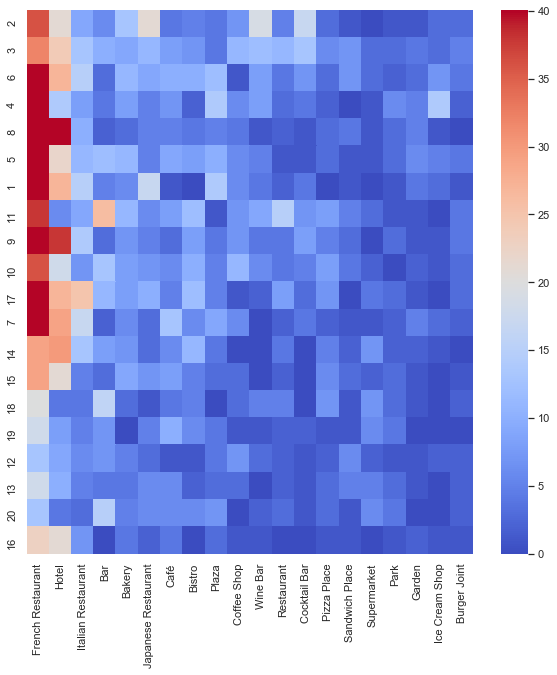

In [407]:
sns.set(rc={'figure.figsize':(10,10)})
sns.heatmap(heat1, cmap='coolwarm', robust = True)
plt.show()